<a href="https://www.kaggle.com/code/saskiadwiulfah18/segment-anything-model-for-brain-mri-segmentation?scriptVersionId=155363687" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
%%capture
!pip install albumentations

In [2]:
%%capture
!pip install -U segmentation-models-pytorch

In [3]:
%%capture
!pip install kaggle

In [4]:
%%capture
!pip install datasets

In [5]:
%%capture
!pip install monai

In [6]:
# Downloading dataset from kaggle
#upload kaggle.json
from google.colab import files
uploaded = files.upload()

!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download -d mateuszbuda/lgg-mri-segmentation -p /content
!unzip /content/lgg-mri-segmentation.zip -d /content/dataset

Streaming output truncated to the last 5000 lines.
  inflating: /content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7294_19890104/TCGA_DU_7294_19890104_9_mask.tif  
  inflating: /content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_1.tif  
  inflating: /content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_10.tif  
  inflating: /content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_10_mask.tif  
  inflating: /content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_11.tif  
  inflating: /content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_11_mask.tif  
  inflating: /content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_12.tif  
  inflating: /content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_12_mask.tif  
  inflating: /conte

In [7]:
import random
import os
import glob
import time
import warnings
import io

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
# import opendatasets as od
import datasets as dts

from PIL import Image
from IPython.display import clear_output
from tqdm.notebook import tqdm
from typing import Dict, List, Tuple
from statistics import mean


import torch
import monai
import cv2
import torchvision
import torch.optim.lr_scheduler as lr_scheduler
from torch import nn
from torch.utils.data import DataLoader
from torch.optim import Adam
from torchvision import transforms
from monai.transforms import Compose, NormalizeIntensityd
from monai.metrics import compute_iou
from sklearn.model_selection import train_test_split

from transformers import SamProcessor
from transformers import SamModel

# CONFIGURATION

In [ ]:
plt.style.use("dark_background")
warnings.filterwarnings("ignore", "is_categorical_dtype")
warnings.filterwarnings("ignore", "use_inf_as_na")

In [24]:
import glob
class CFG:
    DATASET_PATH = "/content/dataset/lgg-mri-segmentation/"
    TRAIN_PATH = "/content/dataset/lgg-mri-segmentation/kaggle_3m/"

    DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    TRAIN_BATCH_SIZE = 2
    TEST_BATCH_SIZE = 1
    LEARNING_RATE = 1e-3
    WEIGHT_DECAY = 0
    EPOCH = 10

# DATA PREPARATION

In [25]:
dataset_images = glob.glob(f"{CFG.TRAIN_PATH}**/*.tif")
dataset_images[:5]

['/content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_HT_8106_19970727/TCGA_HT_8106_19970727_16.tif',
 '/content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_HT_8106_19970727/TCGA_HT_8106_19970727_4_mask.tif',
 '/content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_HT_8106_19970727/TCGA_HT_8106_19970727_19_mask.tif',
 '/content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_HT_8106_19970727/TCGA_HT_8106_19970727_6.tif',
 '/content/dataset/lgg-mri-segmentation/kaggle_3m/TCGA_HT_8106_19970727/TCGA_HT_8106_19970727_20.tif']

In [26]:
def get_sample_patient_id(image_paths):
    return [(_.split('/')[-2:][0]) for _ in image_paths]

def get_sample_number(image_paths):
    sample_numbers = []
    is_mask = []

    for path in image_paths:
        path_list = path.split('/')[-2:][1].split('_')

        if 'mask.tif' in path_list:
            sample_numbers.append(int(path_list[-2]))
            is_mask.append(1)
        else:
            sample_numbers.append(int(path_list[-1].replace('.tif', '')))
            is_mask.append(0)

    return sample_numbers, is_mask

def build_df(image_paths):
    sample_numbers, mask_label = get_sample_number(image_paths)
    df = pd.DataFrame({
        'id'        : sample_numbers,
        'patient'   : get_sample_patient_id(image_paths),
        'image_path': image_paths,
        'is_mask'   : mask_label
    })

    return df

In [27]:
dataset_df = (
    build_df(dataset_images)
    .sort_values(by=['id', 'patient', 'image_path'])
    .reset_index(drop=True)
)

dataset_df

,id,patient,image_path,is_mask
0,1,TCGA_CS_4941_19960909,/content/dataset/lgg-mri-segmentation/kaggle_3...,0
1,1,TCGA_CS_4941_19960909,/content/dataset/lgg-mri-segmentation/kaggle_3...,1
2,1,TCGA_CS_4942_19970222,/content/dataset/lgg-mri-segmentation/kaggle_3...,0
3,1,TCGA_CS_4942_19970222,/content/dataset/lgg-mri-segmentation/kaggle_3...,1
4,1,TCGA_CS_4943_20000902,/content/dataset/lgg-mri-segmentation/kaggle_3...,0
...,...,...,...,...
7853,87,TCGA_HT_A61B_19991127,/content/dataset/lgg-mri-segmentation/kaggle_3...,1
7854,88,TCGA_HT_A61A_20000127,/content/dataset/lgg-mri-segmentation/kaggle_3...,0
7855,88,TCGA_HT_A61A_20000127,/content/dataset/lgg-mri-segmentation/kaggle_3...,1
7856,88,TCGA_HT_A61B_19991127,/content/dataset/lgg-mri-segmentation/kaggle_3...,0


In [28]:
grouped_df = dataset_df.groupby(by='is_mask')
images_df, mask_df = (
    grouped_df.get_group(0).drop('is_mask', axis=1).reset_index(drop=True),
    grouped_df.get_group(1).drop('is_mask', axis=1).reset_index(drop=True)
)

mask_df = mask_df.rename({'image_path': 'mask_path'}, axis=1)

mask_df.head()

,id,patient,mask_path
0,1,TCGA_CS_4941_19960909,/content/dataset/lgg-mri-segmentation/kaggle_3...
1,1,TCGA_CS_4942_19970222,/content/dataset/lgg-mri-segmentation/kaggle_3...
2,1,TCGA_CS_4943_20000902,/content/dataset/lgg-mri-segmentation/kaggle_3...
3,1,TCGA_CS_4944_20010208,/content/dataset/lgg-mri-segmentation/kaggle_3...
4,1,TCGA_CS_5393_19990606,/content/dataset/lgg-mri-segmentation/kaggle_3...


In [29]:
def _load(image_path, as_tensor=True):
    image = Image.open(image_path)
    return np.array(image).astype(np.float32) / 255.

def generate_label(mask_path, load_fn):
    mask = load_fn(mask_path)
    if mask.max() > 0:
        return 1
    return 0

In [30]:
ds = images_df.merge(
    mask_df,
    on=['id', 'patient'],
    how='left'
)

ds['diagnosis'] = [generate_label(_, _load) for _ in tqdm(ds['mask_path'])]
ds.head()

  0%|          | 0/3929 [00:00<?, ?it/s]

,id,patient,image_path,mask_path,diagnosis
0,1,TCGA_CS_4941_19960909,/content/dataset/lgg-mri-segmentation/kaggle_3...,/content/dataset/lgg-mri-segmentation/kaggle_3...,0
1,1,TCGA_CS_4942_19970222,/content/dataset/lgg-mri-segmentation/kaggle_3...,/content/dataset/lgg-mri-segmentation/kaggle_3...,0
2,1,TCGA_CS_4943_20000902,/content/dataset/lgg-mri-segmentation/kaggle_3...,/content/dataset/lgg-mri-segmentation/kaggle_3...,0
3,1,TCGA_CS_4944_20010208,/content/dataset/lgg-mri-segmentation/kaggle_3...,/content/dataset/lgg-mri-segmentation/kaggle_3...,0
4,1,TCGA_CS_5393_19990606,/content/dataset/lgg-mri-segmentation/kaggle_3...,/content/dataset/lgg-mri-segmentation/kaggle_3...,0


In [31]:
ds = ds[ds['diagnosis']==1]
ds = ds.head(1360)

In [32]:
image_train, image_test, mask_train, mask_test = train_test_split(
ds['image_path'], ds['mask_path'], test_size = 0.10)

In [33]:
train_df = pd.concat([image_train, mask_train], axis=1).reset_index(drop=True)
train_dataset = dts.Dataset.from_pandas(train_df)

In [34]:
test_df = pd.concat([image_test, mask_test], axis=1).reset_index(drop=True)
test_dataset = dts.Dataset.from_pandas(test_df)

In [35]:
def transform(data):
    with open(data['image_path'], 'rb') as f:
        image = Image.open(io.BytesIO(f.read())).convert('RGB')
    data['image'] = image

    with open(data['mask_path'], 'rb') as f:
        mask = Image.open(io.BytesIO(f.read())).convert('L')
    data['mask'] = mask

    return data

In [36]:
train_dataset = train_dataset.map(transform, remove_columns=['image_path','mask_path'])

Map:   0%|          | 0/1224 [00:00<?, ? examples/s]

In [37]:
train_dataset

Dataset({
    features: ['image', 'mask'],
    num_rows: 1224
})

In [38]:
test_dataset = test_dataset.map(transform, remove_columns=['image_path','mask_path'])

Map:   0%|          | 0/136 [00:00<?, ? examples/s]

In [39]:
test_dataset

Dataset({
    features: ['image', 'mask'],
    num_rows: 136
})

In [40]:
example = train_dataset[0]
img = example['image']
msk = example['mask']

In [41]:
np.array(msk).max(), np.array(msk).min(), np.array(img).max(), np.array(img).min()

(255, 0, 230, 0)

In [42]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

(-0.5, 255.5, 255.5, -0.5)

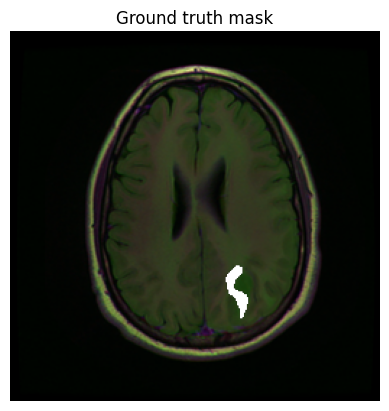

In [43]:
fig, axes = plt.subplots()

axes.imshow(np.array(img))
ground_truth_seg = np.array(example["mask"])
show_mask(ground_truth_seg, axes)
axes.title.set_text(f"Ground truth mask")
axes.axis("off")

In [44]:
def get_bounding_box(ground_truth_map):
    if len(np.unique(ground_truth_map)) > 1:

        y_indices, x_indices = np.where(ground_truth_map > 0)
        x_min, x_max = np.min(x_indices), np.max(x_indices)
        y_min, y_max = np.min(y_indices), np.max(y_indices)

        H, W = ground_truth_map.shape
        x_min = max(0, x_min - np.random.randint(5, 20))
        x_max = min(W, x_max + np.random.randint(5, 20))
        y_min = max(0, y_min - np.random.randint(5, 20))
        y_max = min(H, y_max + np.random.randint(5, 20))

        bbox = [x_min, y_min, x_max, y_max]

        return bbox
    else:
        return [0, 0, 256, 256]

In [45]:
class SAMDataset(torch.utils.data.Dataset):
  def __init__(self, dataset, processor):
    self.dataset = dataset
    self.processor = processor

  def __len__(self):
    return len(self.dataset)

  def __getitem__(self, idx):
    item = self.dataset[idx]
    image = item["image"]
    ground_truth_mask = np.array(item["mask"])
    prompt = get_bounding_box(ground_truth_mask)
    inputs = self.processor(image, input_boxes=[[prompt]], return_tensors="pt")
    inputs = {k:v.squeeze(0) for k,v in inputs.items()}
    inputs["ground_truth_mask"] = ground_truth_mask/255

    return inputs

In [46]:
processor = SamProcessor.from_pretrained("facebook/sam-vit-base", do_normalize=False)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

In [47]:
train_sam_ds = SAMDataset(dataset=train_dataset, processor=processor)

In [48]:
exmpl = train_sam_ds[10]
for k,v in exmpl.items():
  print(k,v.shape)

pixel_values torch.Size([3, 1024, 1024])
original_sizes torch.Size([2])
reshaped_input_sizes torch.Size([2])
input_boxes torch.Size([1, 4])
ground_truth_mask (256, 256)


In [49]:
train_dataloader = DataLoader(train_sam_ds, batch_size=CFG.TRAIN_BATCH_SIZE, shuffle=False)

In [50]:
batch = next(iter(train_dataloader))
for k,v in batch.items():
  print(k,v.shape)

pixel_values torch.Size([2, 3, 1024, 1024])
original_sizes torch.Size([2, 2])
reshaped_input_sizes torch.Size([2, 2])
input_boxes torch.Size([2, 1, 4])
ground_truth_mask torch.Size([2, 256, 256])


In [51]:
train_df.shape

(1224, 2)

# Modeling

In [52]:
model = SamModel.from_pretrained("facebook/sam-vit-base")
for name, param in model.named_parameters():
  if name.startswith("vision_encoder") or name.startswith("prompt_encoder"):
    param.requires_grad_(False)

config.json:   0%|          | 0.00/6.57k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/375M [00:00<?, ?B/s]

In [53]:
optimizer = Adam(model.mask_decoder.parameters(), lr=CFG.LEARNING_RATE, weight_decay=CFG.WEIGHT_DECAY)
seg_loss = monai.losses.FocalLoss(reduction='mean')

In [54]:
num_epochs = CFG.EPOCH

device = CFG.DEVICE
model.to(device)

model.train()
epoch_losses = []
epoch_ious = []


for epoch in range(num_epochs):
    print(f'EPOCH: {epoch}')
    batch_losses = []
    batch_ious = []

    for i, batch in enumerate(tqdm(train_dataloader)):

      outputs = model(pixel_values=batch["pixel_values"].to(device),
                      input_boxes=batch["input_boxes"].to(device),
                      multimask_output=False)

      predicted_masks = outputs.pred_masks.squeeze(1)
      ground_truth_masks = batch["ground_truth_mask"].float().to(device)

      sam_masks_prob = torch.sigmoid(predicted_masks)
      sam_masks_prob = sam_masks_prob.squeeze()
      sam_masks = (sam_masks_prob > 0.5)

      loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))
      batch_losses.append(loss.item())
      ious = compute_iou(sam_masks.unsqueeze(1),
                        ground_truth_masks.unsqueeze(1), ignore_empty=False)
      batch_ious.append(ious.mean())

      optimizer.zero_grad()
      loss.backward()

      optimizer.step()

      if torch.cuda.is_available():
        torch.cuda.empty_cache()

    mean_loss = mean(batch_losses)
    epoch_losses.append(mean_loss)
    print(f'Mean loss: {mean_loss}')

    mean_iou = mean([t.cpu().item() for t in batch_ious])
    epoch_ious.append(mean_iou)
    print(f'Mean IoU: {mean_iou}')

EPOCH: 0


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.03571149127122648
Mean IoU: 0.4311623206822273
EPOCH: 1


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.00652493868465231
Mean IoU: 0.6030336895229422
EPOCH: 2


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.006812865443351173
Mean IoU: 0.587790757476267
EPOCH: 3


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005670541580127296
Mean IoU: 0.6336204750536412
EPOCH: 4


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005420954284536671
Mean IoU: 0.6471635458345701
EPOCH: 5


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005324306357591078
Mean IoU: 0.6555181915317875
EPOCH: 6


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005447991749498494
Mean IoU: 0.6449037137867623
EPOCH: 7


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005255674440573499
Mean IoU: 0.6604443448626138
EPOCH: 8


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.004993320841820046
Mean IoU: 0.6689293200478834
EPOCH: 9


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005019378924272114
Mean IoU: 0.6669511901080803


In [55]:
sam_masks.shape

torch.Size([2, 256, 256])

Text(0, 0.5, 'Loss')

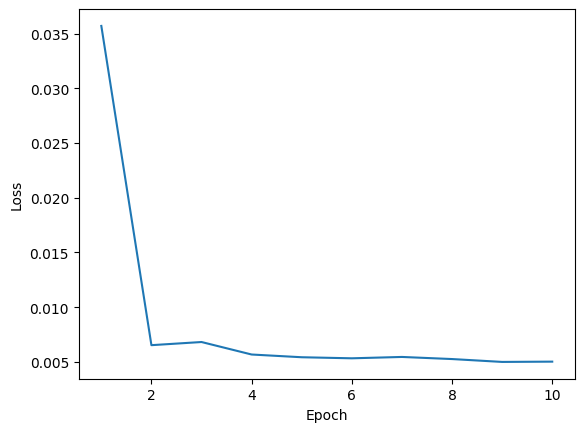

In [56]:
plt.plot(np.arange(1,CFG.EPOCH+1), epoch_losses)
plt.xlabel('Epoch')
plt.ylabel('Loss')

Text(0, 0.5, 'IoU')

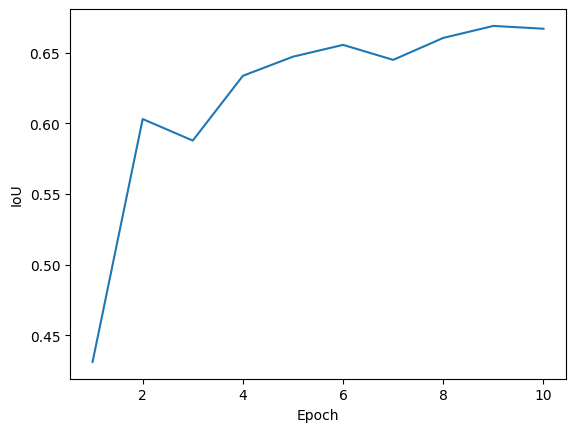

In [57]:
plt.plot(np.arange(1,CFG.EPOCH+1), epoch_ious)
plt.xlabel('Epoch')
plt.ylabel('IoU')

# INFERENCE

## Inference with DataLoader

In [58]:
# create test dataloader
test_sam_ds = SAMDataset(test_dataset, processor=processor)
test_dataloader = DataLoader(test_sam_ds, batch_size=CFG.TEST_BATCH_SIZE, shuffle=False)

  0%|          | 0/136 [00:00<?, ?it/s]

IoU: tensor([[0.6105]])


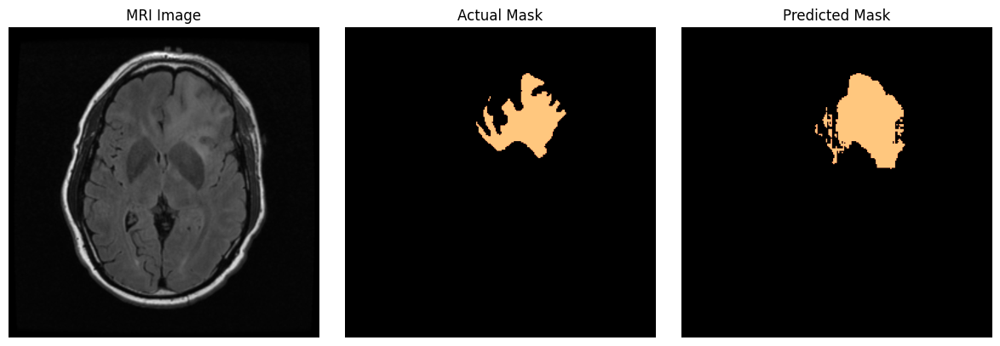

IoU: tensor([[0.7929]])


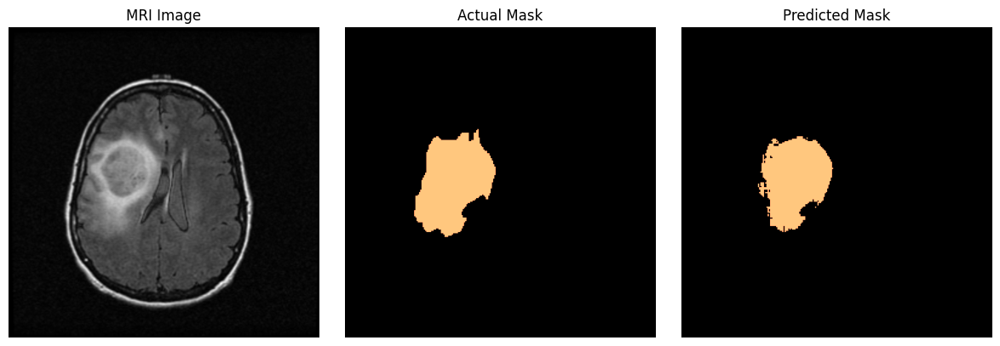

IoU: tensor([[0.8773]])


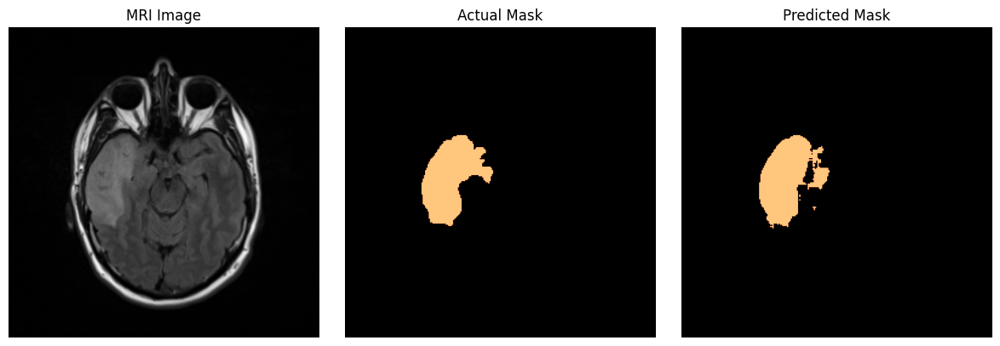

IoU: tensor([[0.6992]])


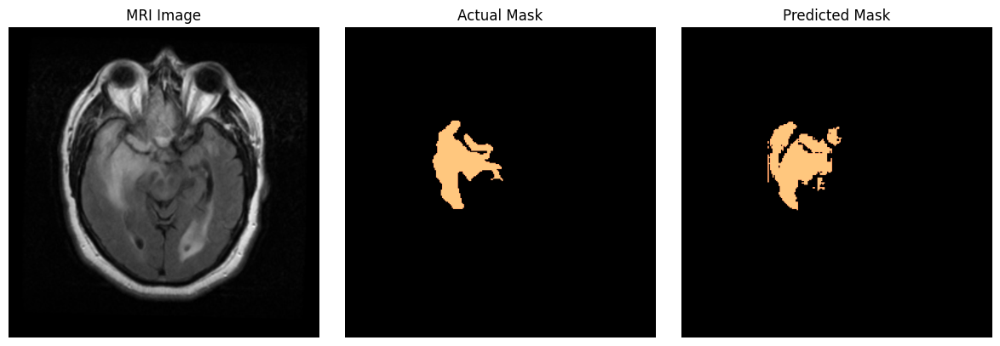

IoU: tensor([[0.8082]])


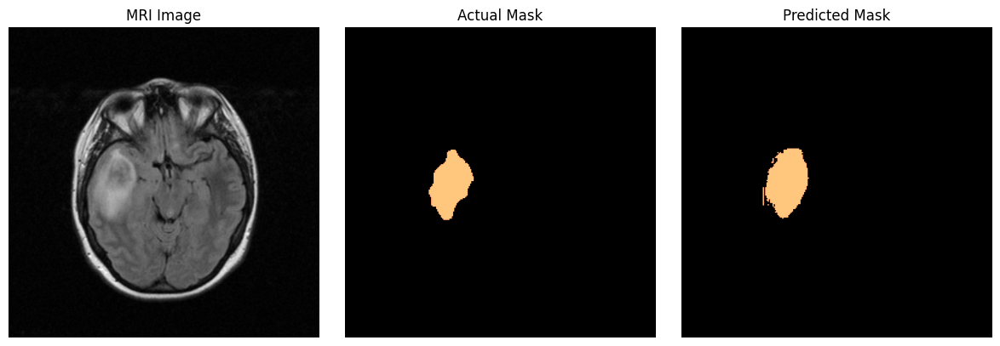

IoU: tensor([[0.8040]])


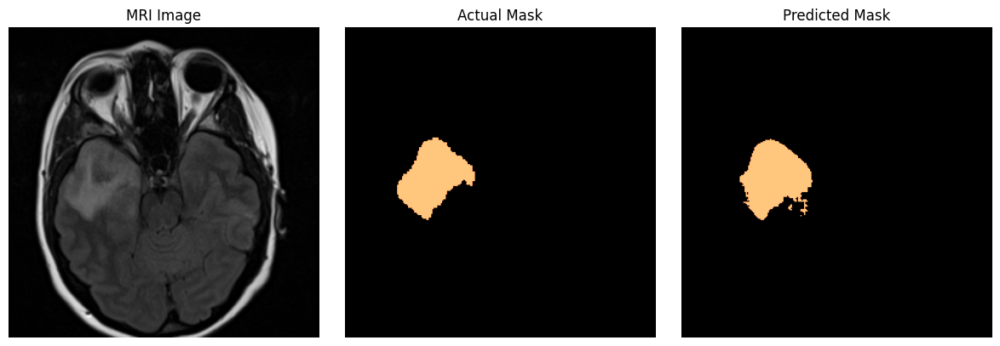

IoU: tensor([[0.5322]])


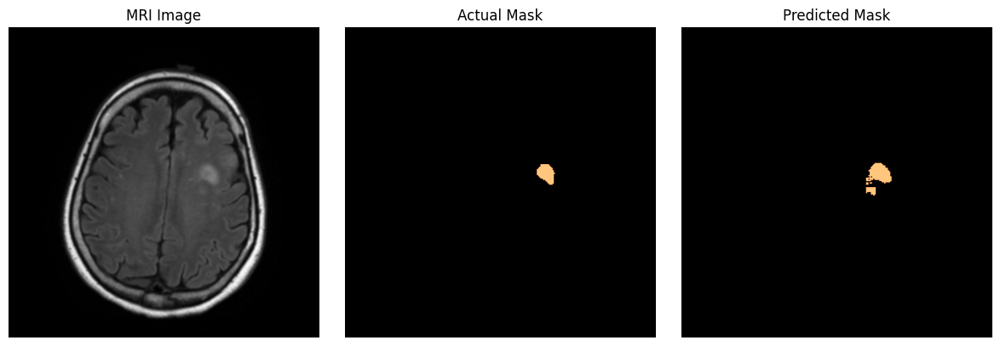

IoU: tensor([[0.6131]])


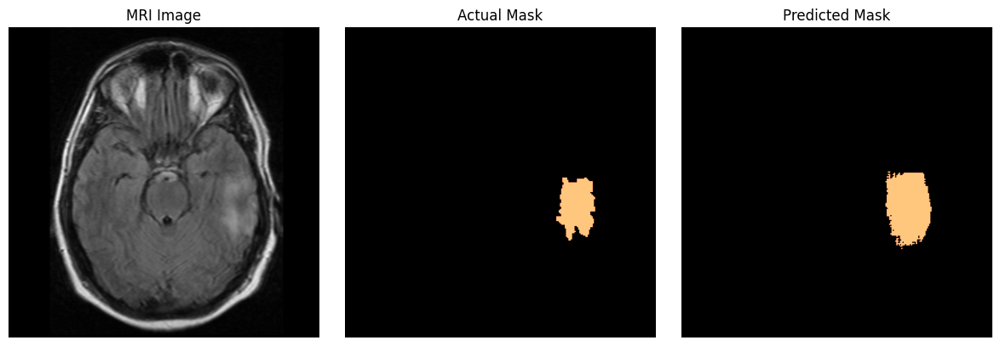

IoU: tensor([[0.6737]])


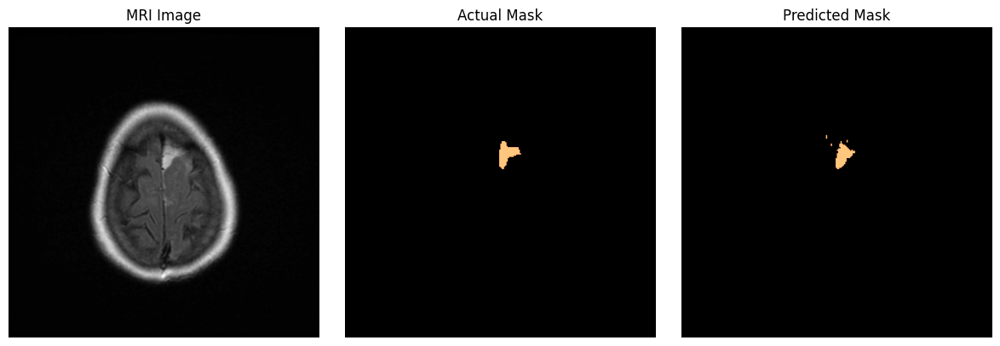

IoU: tensor([[0.7447]])


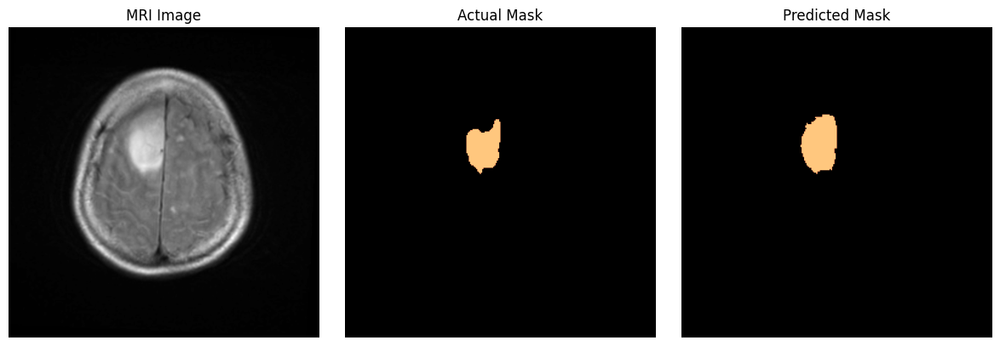

IoU: tensor([[0.7861]])


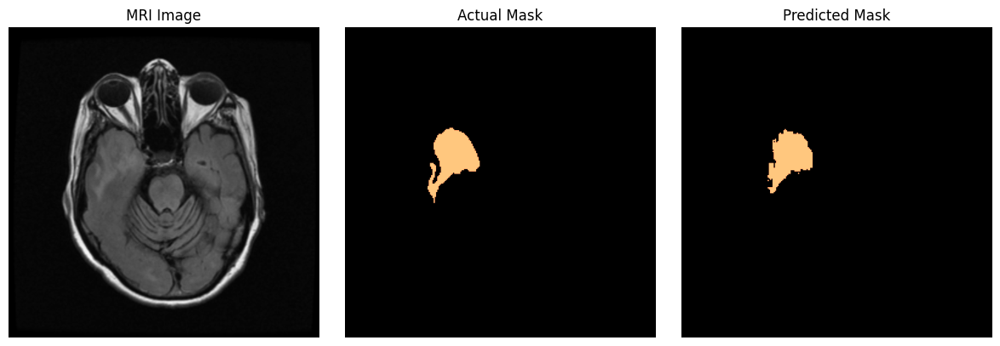

IoU: tensor([[0.]])


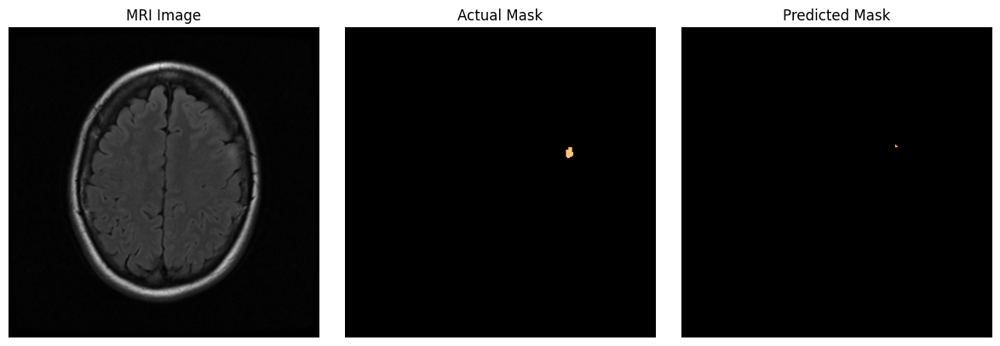

IoU: tensor([[0.8017]])


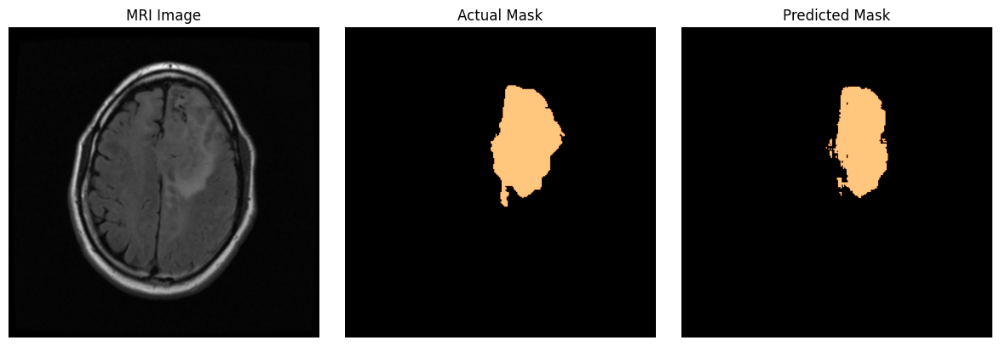

IoU: tensor([[0.9510]])


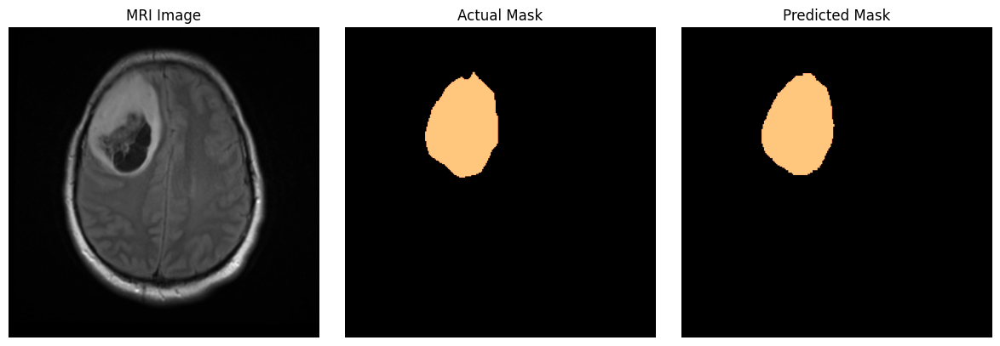

IoU: tensor([[0.8182]])


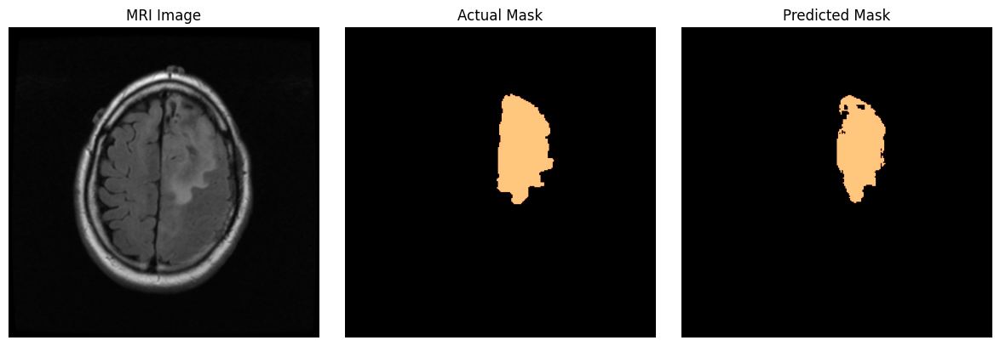

IoU: tensor([[0.8671]])


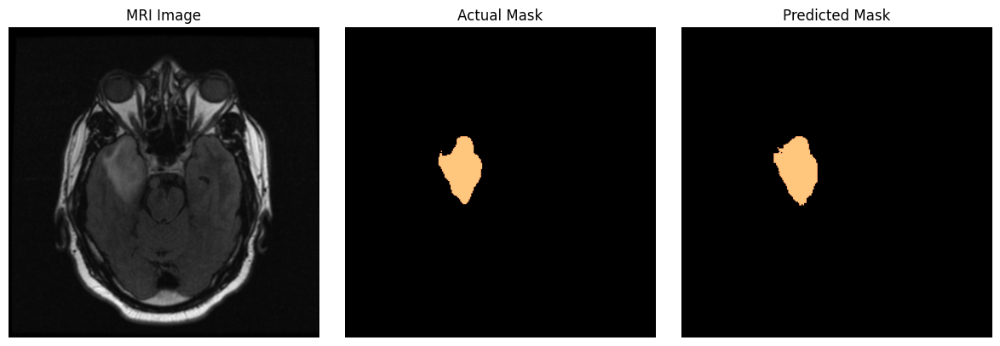

IoU: tensor([[0.6800]])


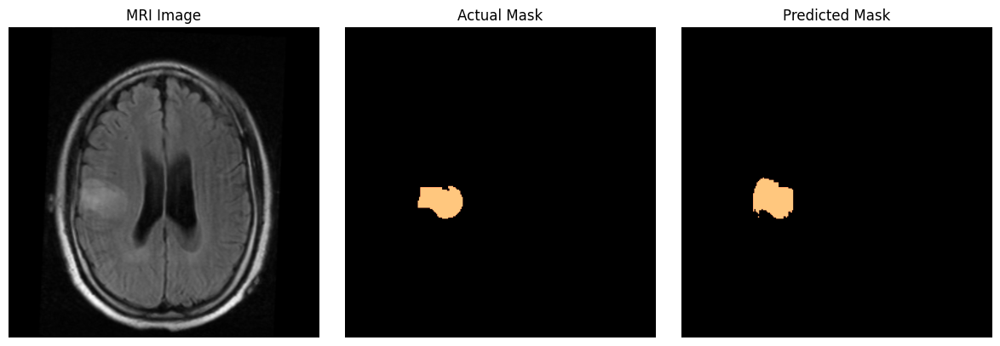

IoU: tensor([[0.0731]])


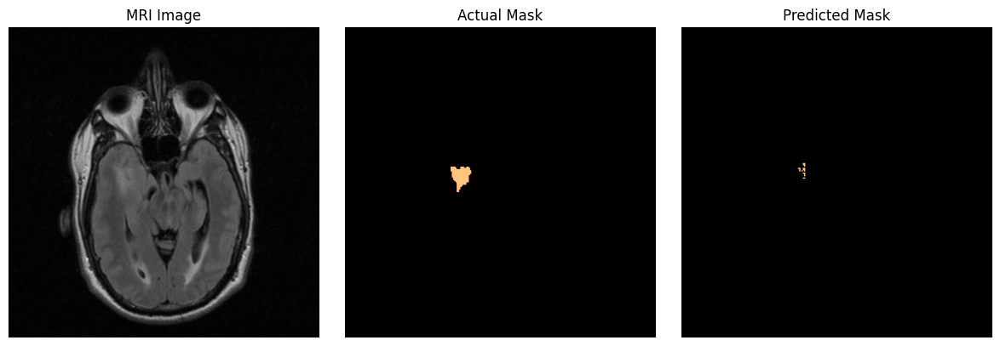

IoU: tensor([[0.7674]])


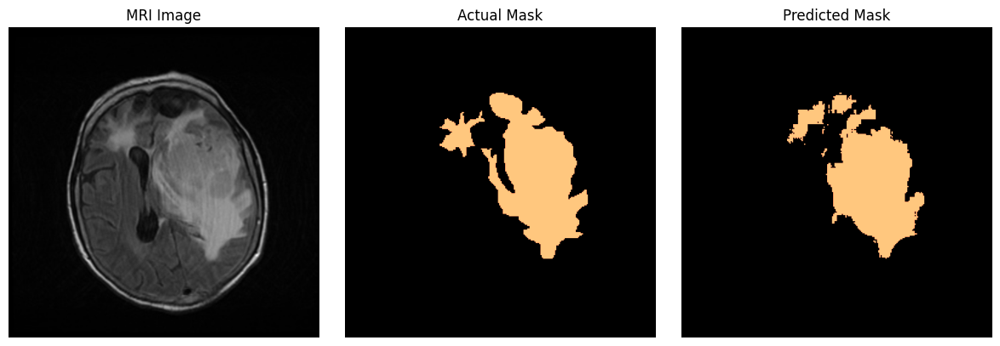

IoU: tensor([[0.7605]])


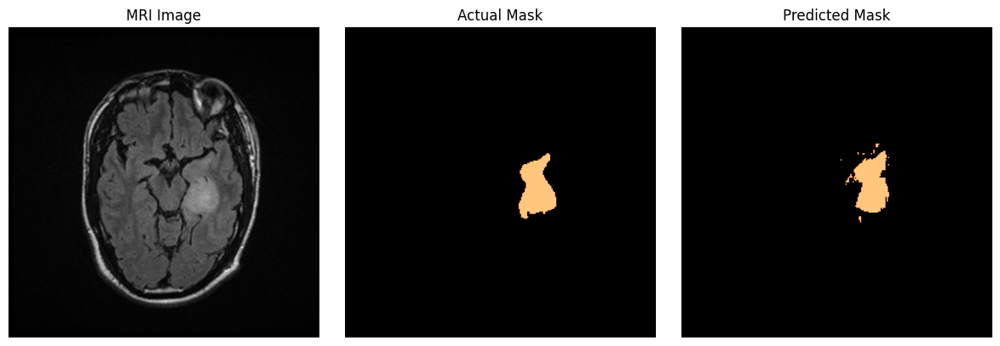

IoU: tensor([[0.7213]])


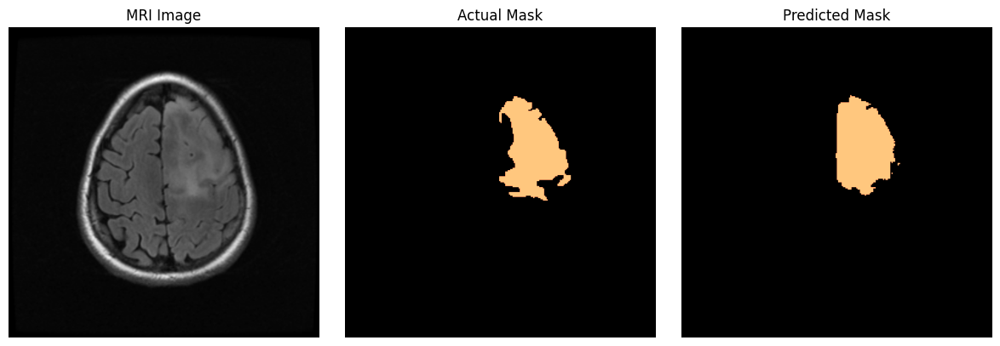

IoU: tensor([[0.8234]])


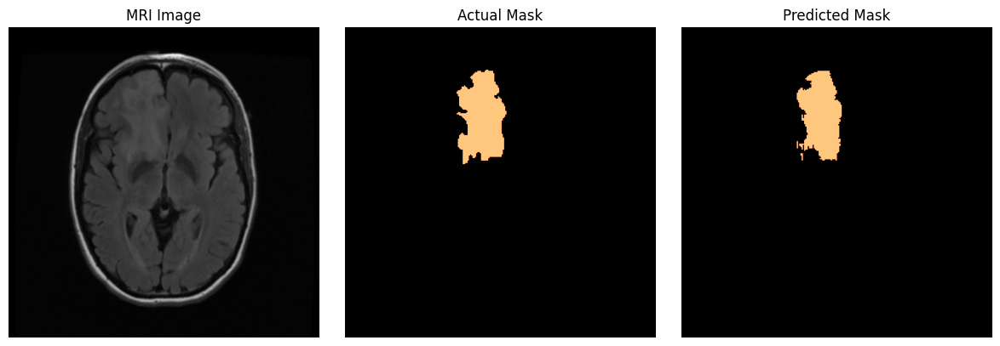

IoU: tensor([[0.8530]])


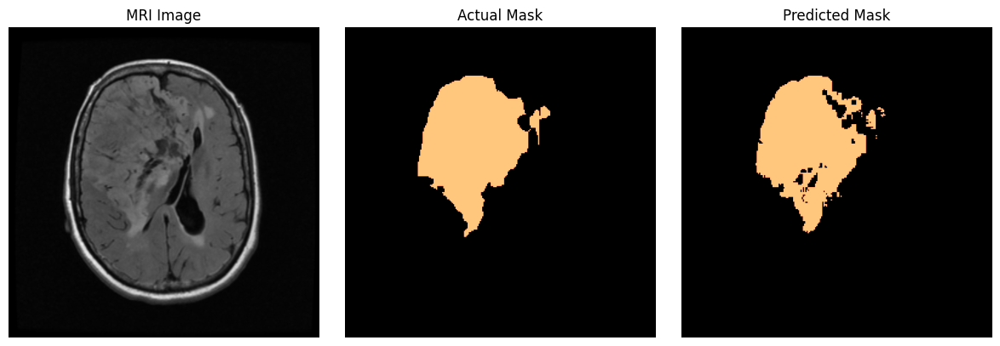

IoU: tensor([[0.9273]])


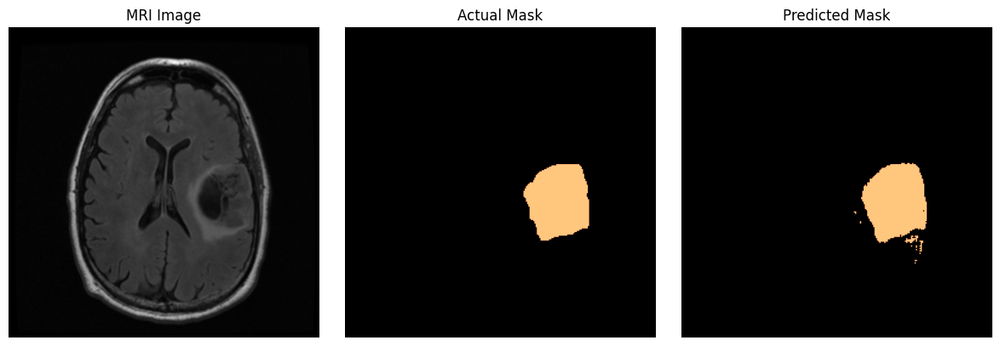

IoU: tensor([[0.6423]])


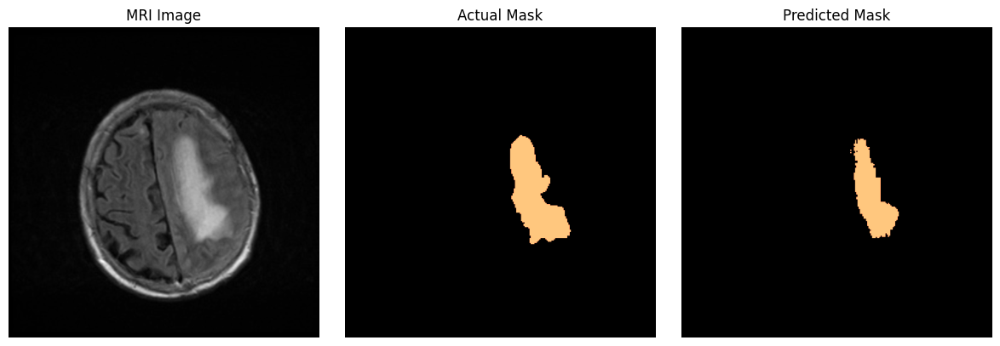

IoU: tensor([[0.8664]])


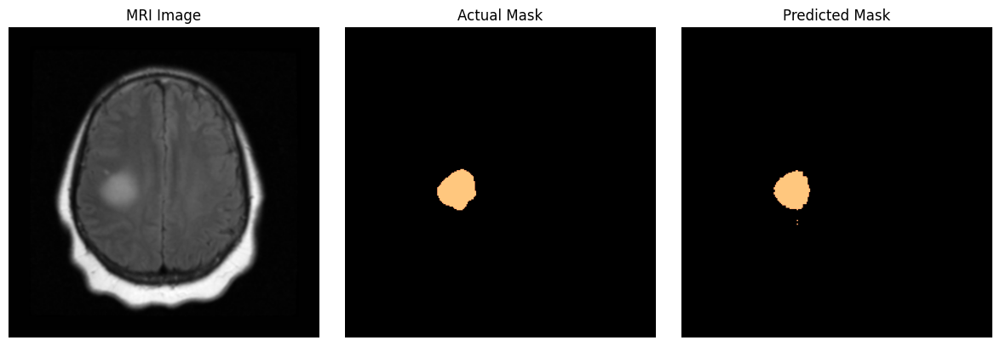

IoU: tensor([[0.4942]])


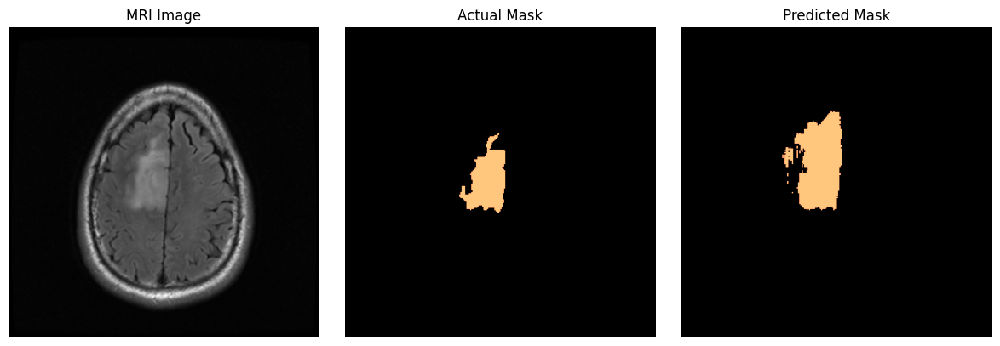

IoU: tensor([[0.8819]])


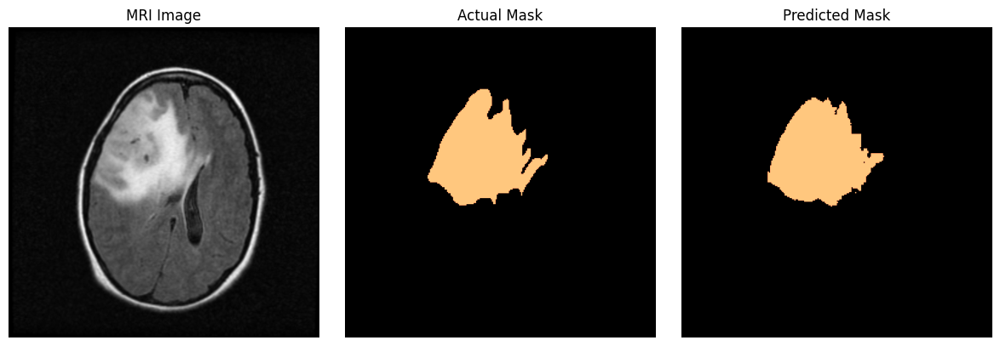

IoU: tensor([[0.8387]])


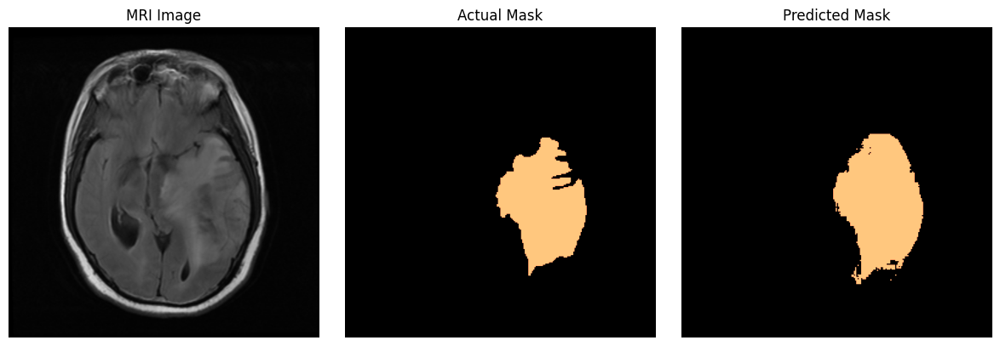

IoU: tensor([[0.7935]])


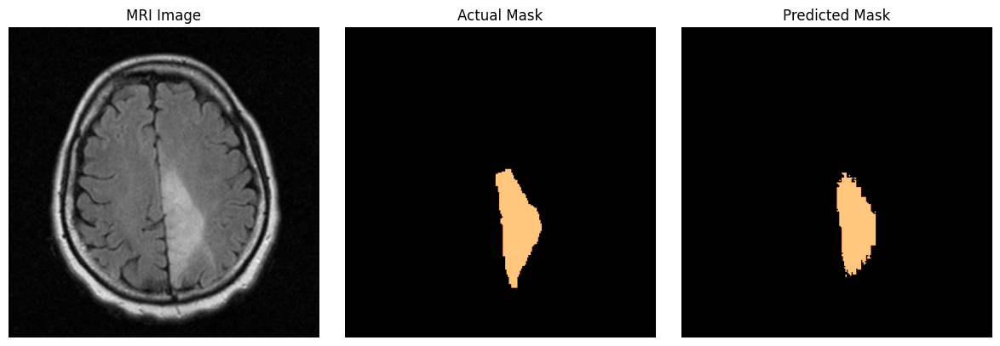

IoU: tensor([[0.8605]])


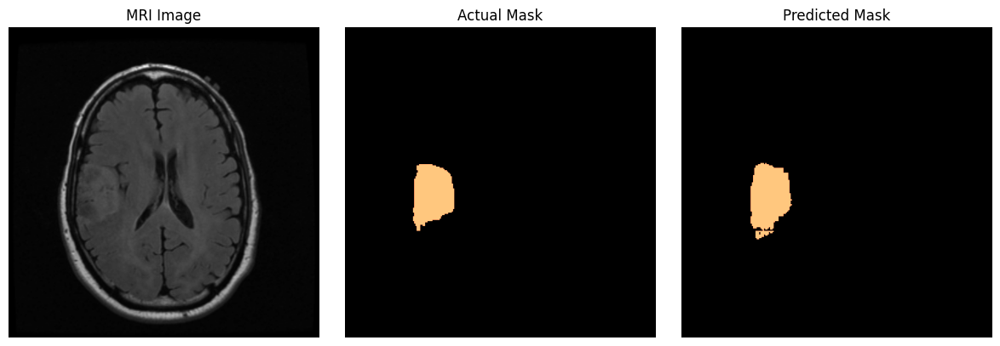

IoU: tensor([[0.8093]])


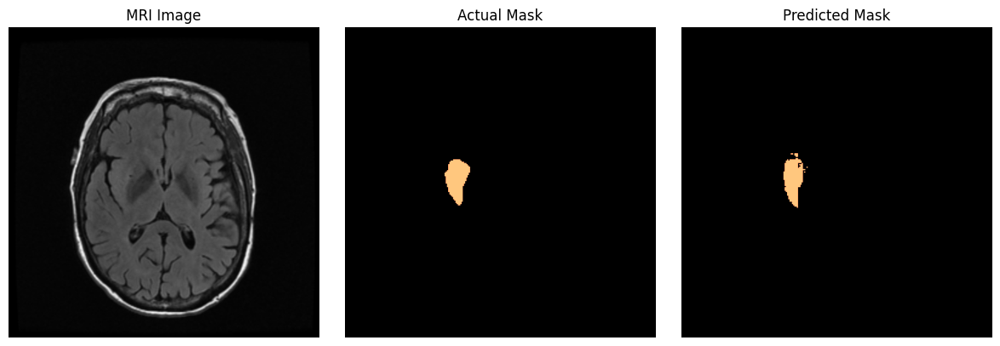

IoU: tensor([[0.5408]])


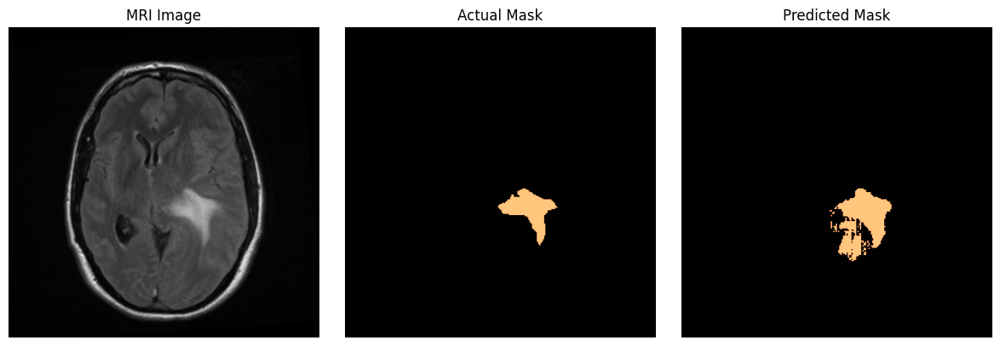

IoU: tensor([[0.5460]])


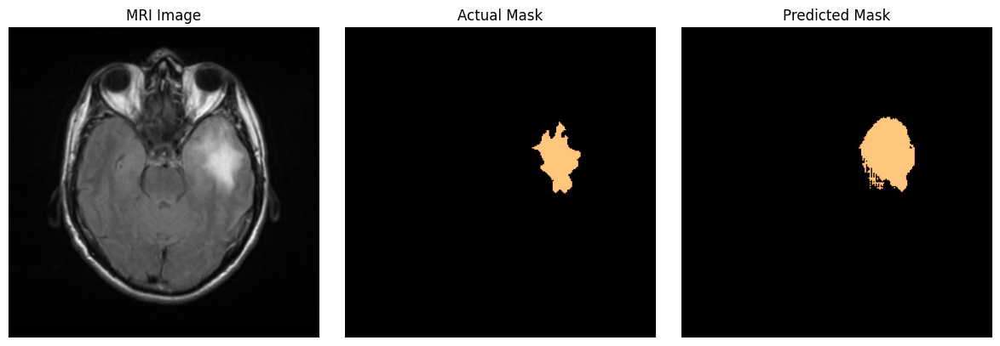

IoU: tensor([[0.8193]])


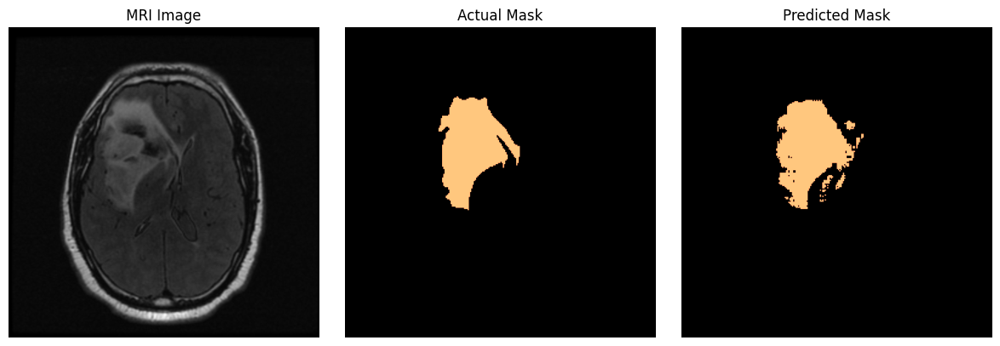

IoU: tensor([[0.6445]])


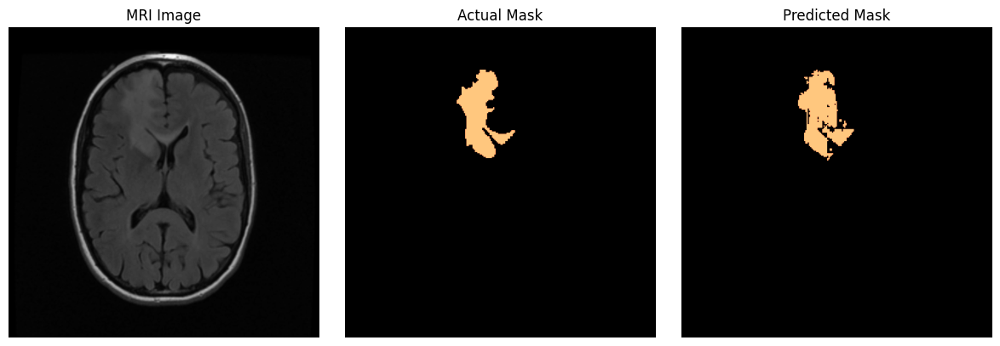

IoU: tensor([[0.8191]])


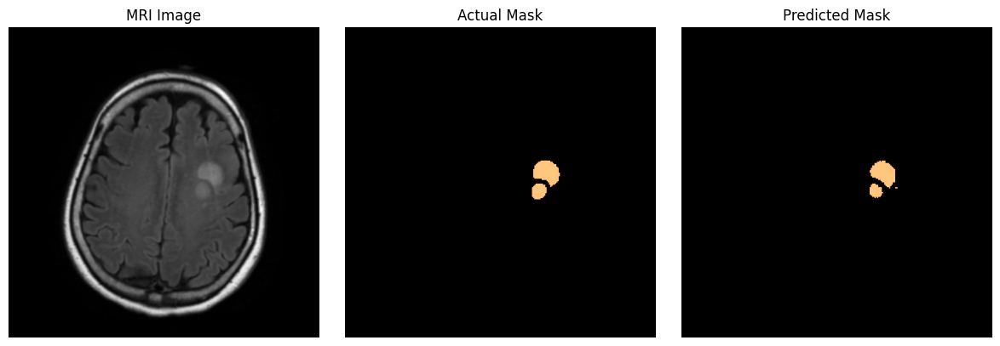

IoU: tensor([[0.6431]])


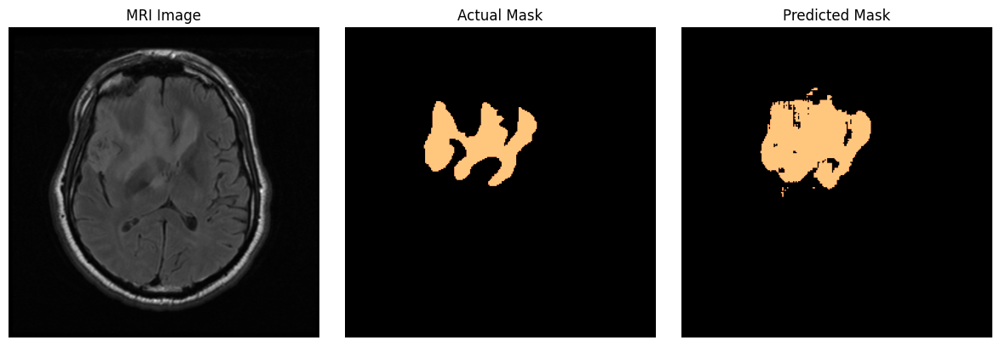

IoU: tensor([[0.4351]])


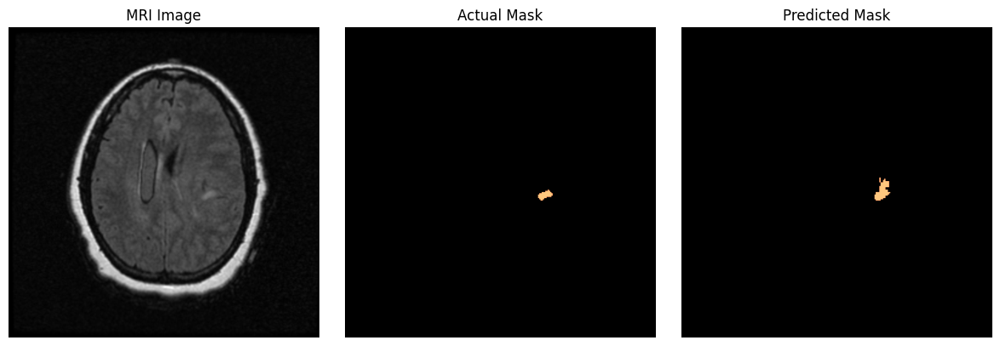

IoU: tensor([[0.9296]])


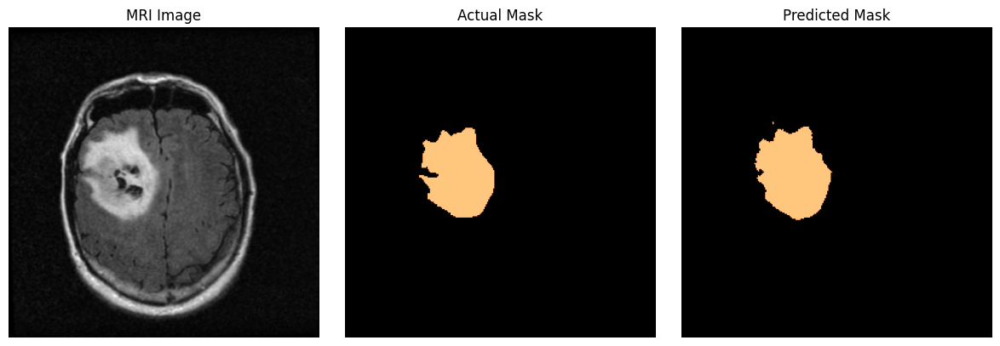

IoU: tensor([[0.7271]])


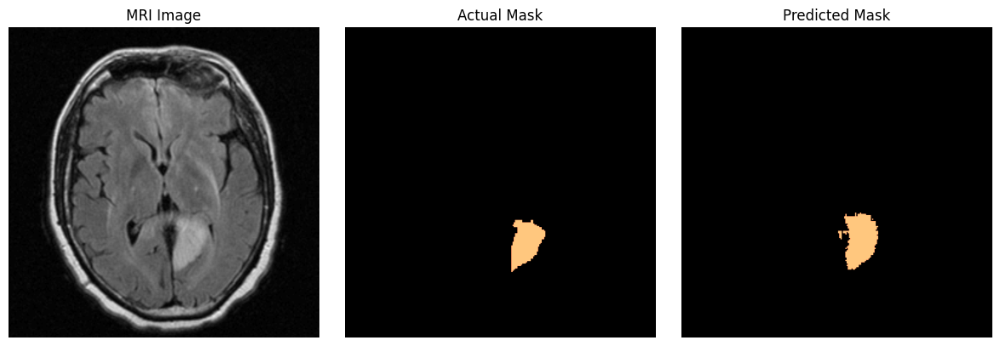

IoU: tensor([[0.6868]])


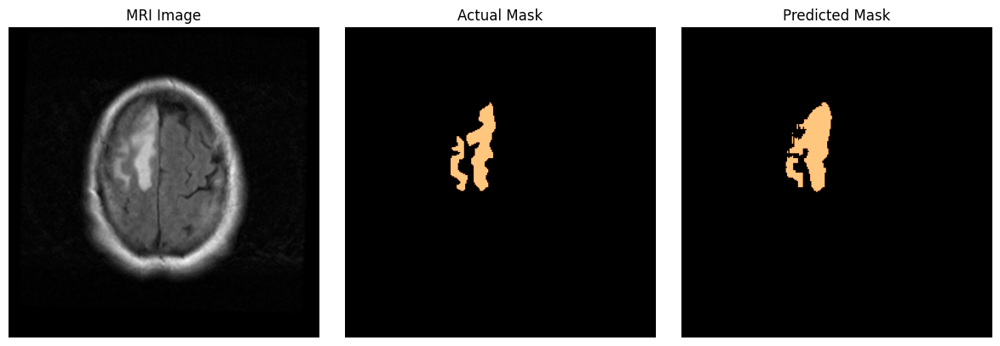

IoU: tensor([[0.8003]])


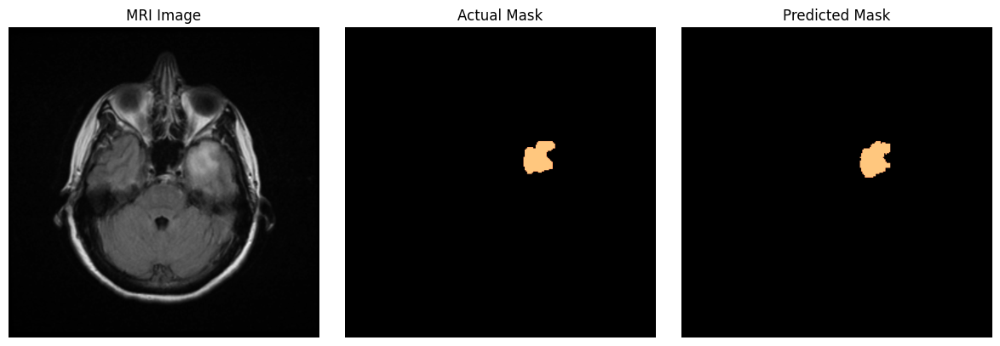

IoU: tensor([[0.6531]])


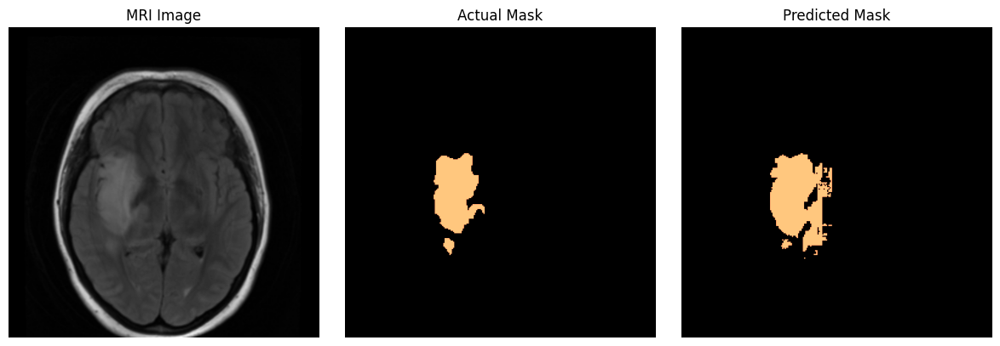

IoU: tensor([[0.8610]])


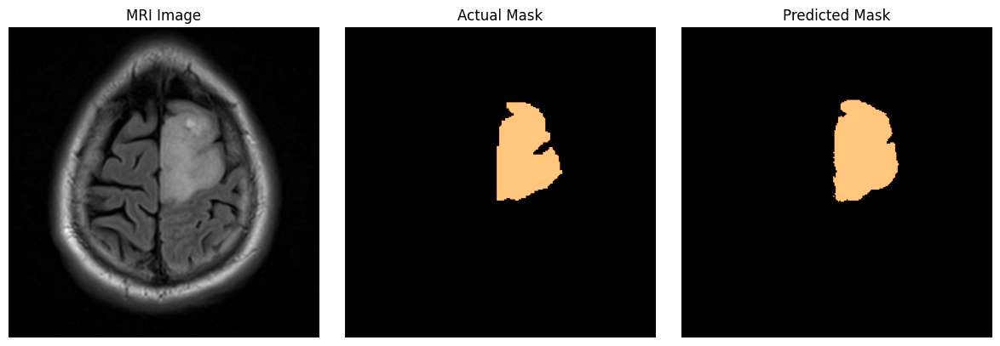

IoU: tensor([[0.4565]])


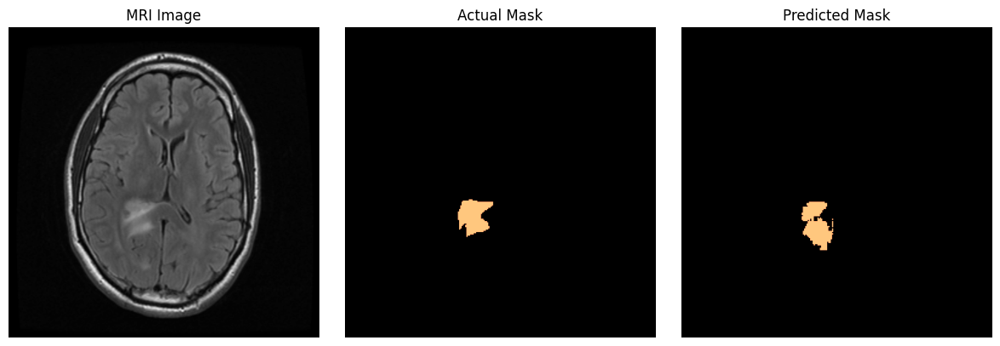

IoU: tensor([[0.3213]])


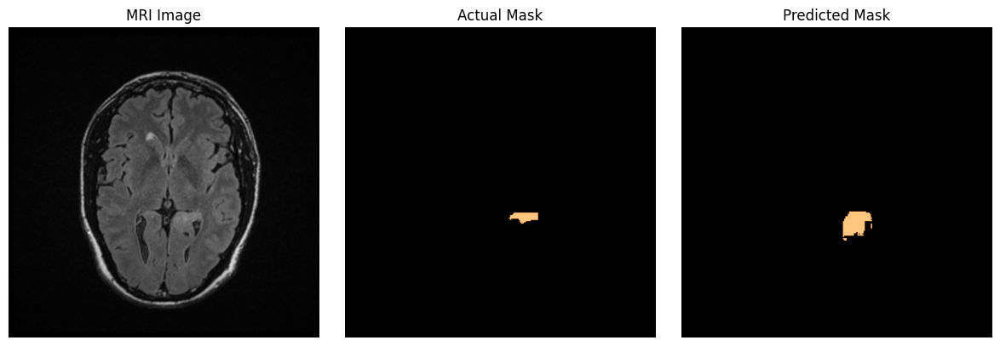

IoU: tensor([[0.6622]])


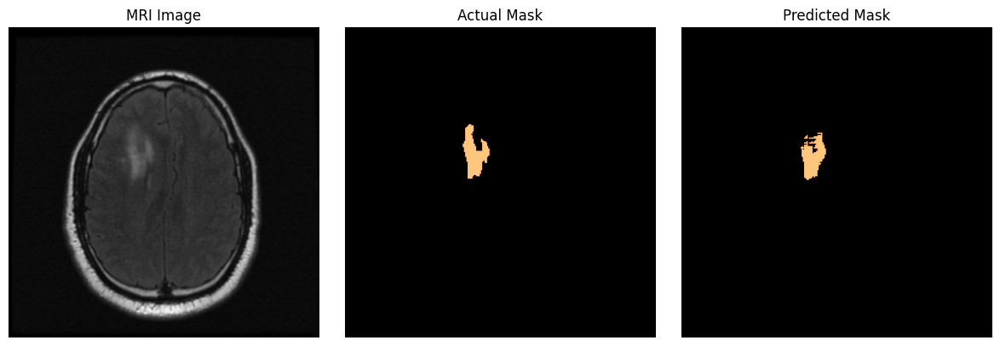

IoU: tensor([[0.7320]])


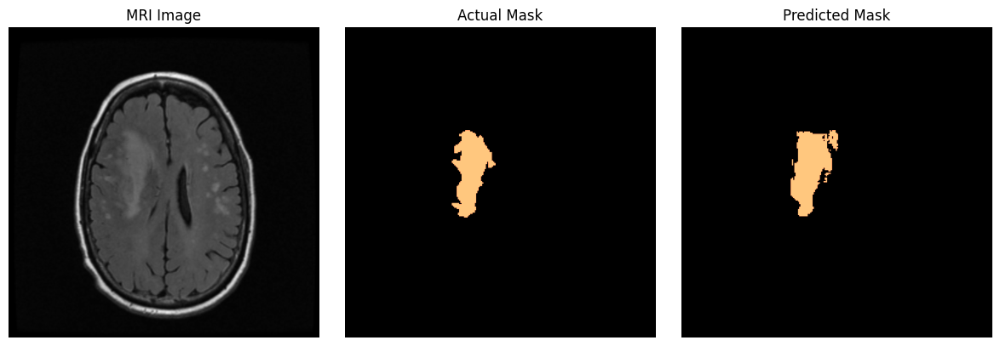

IoU: tensor([[0.6438]])


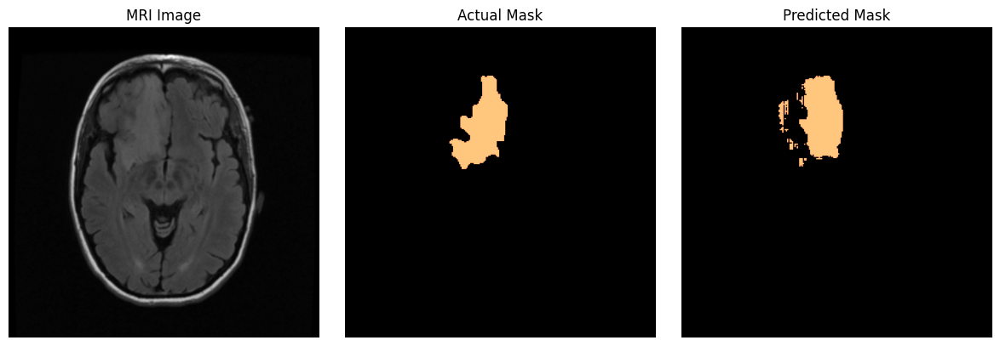

IoU: tensor([[0.8794]])


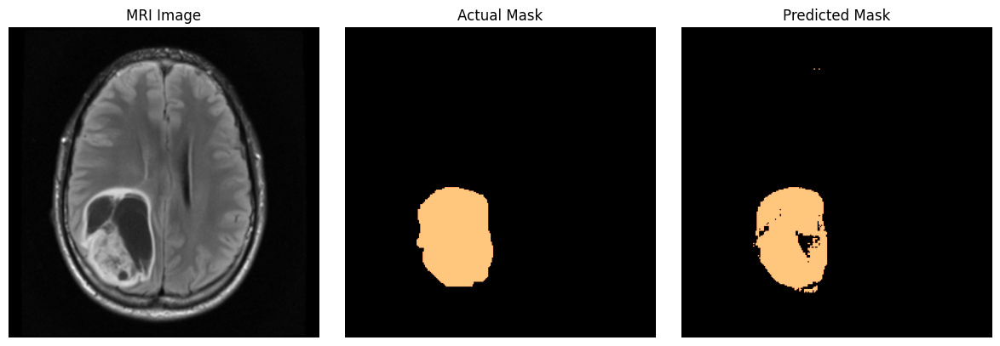

IoU: tensor([[0.8369]])


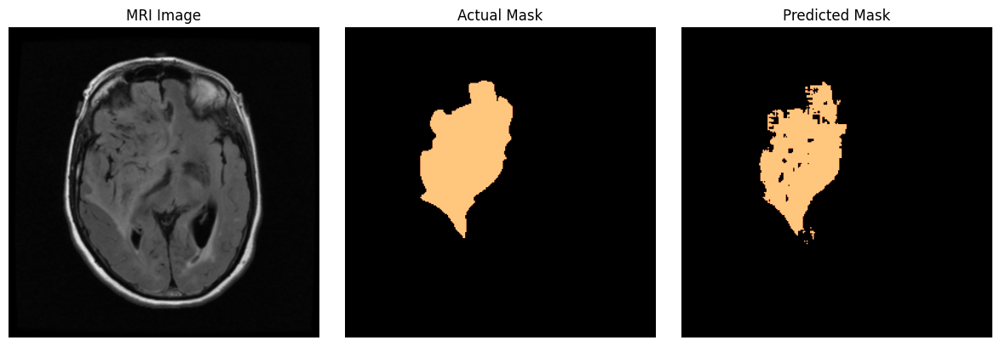

IoU: tensor([[0.8851]])


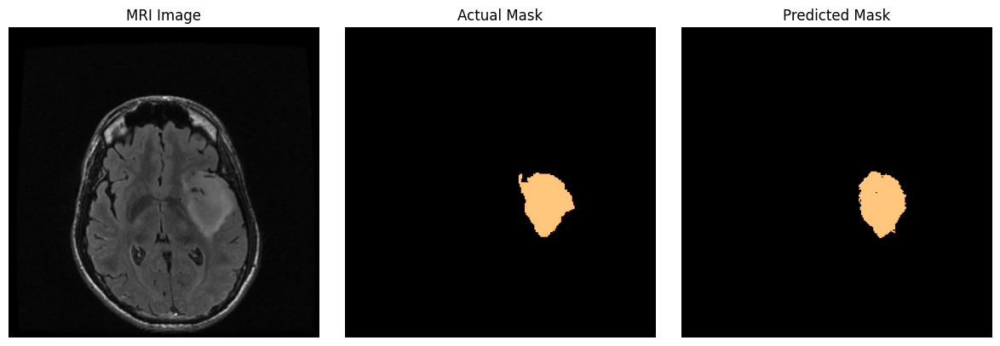

IoU: tensor([[0.5693]])


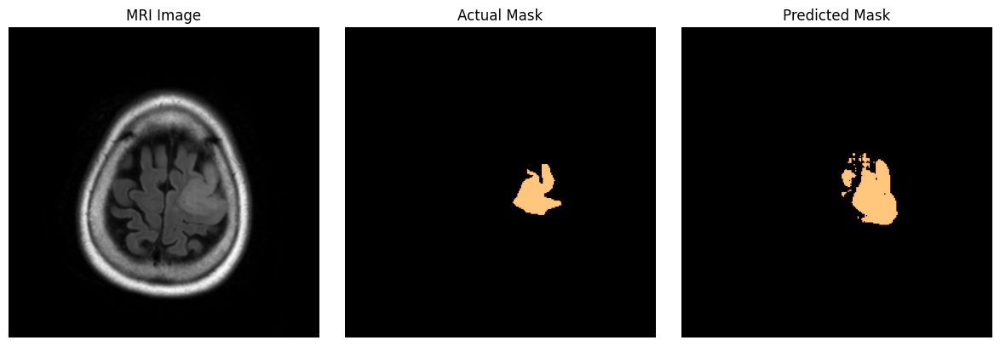

IoU: tensor([[0.]])


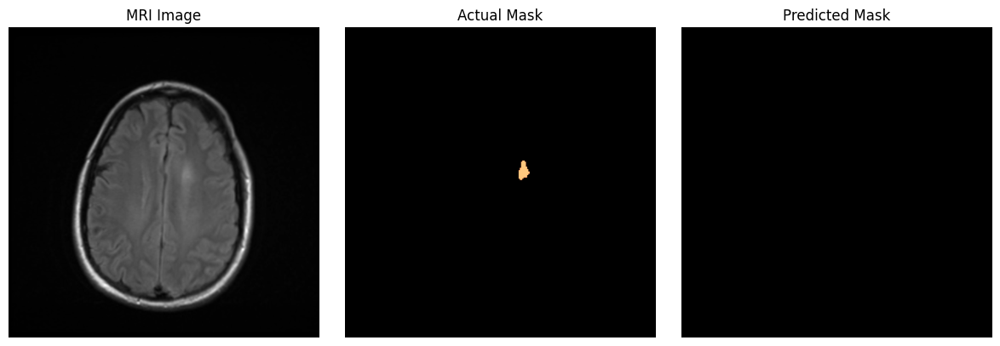

IoU: tensor([[0.3582]])


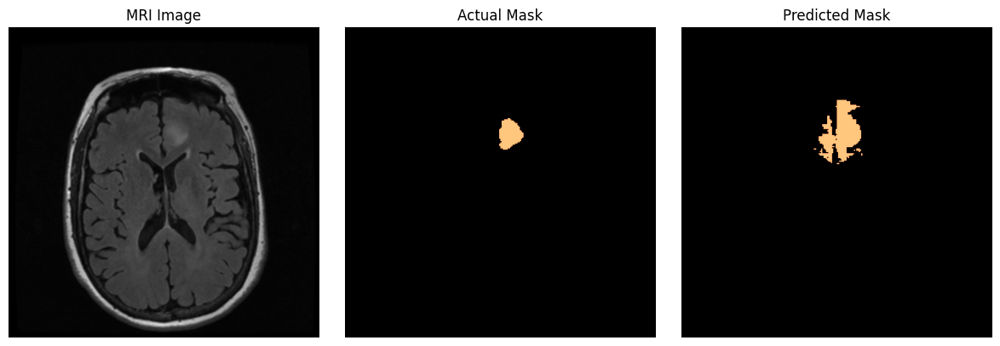

IoU: tensor([[0.6577]])


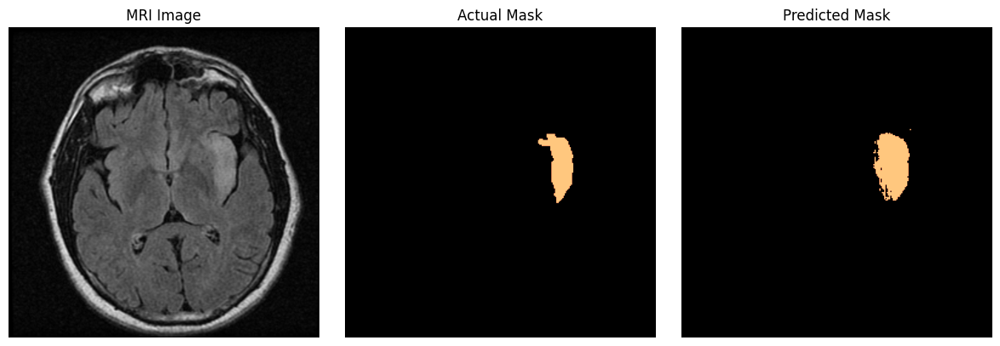

IoU: tensor([[0.8673]])


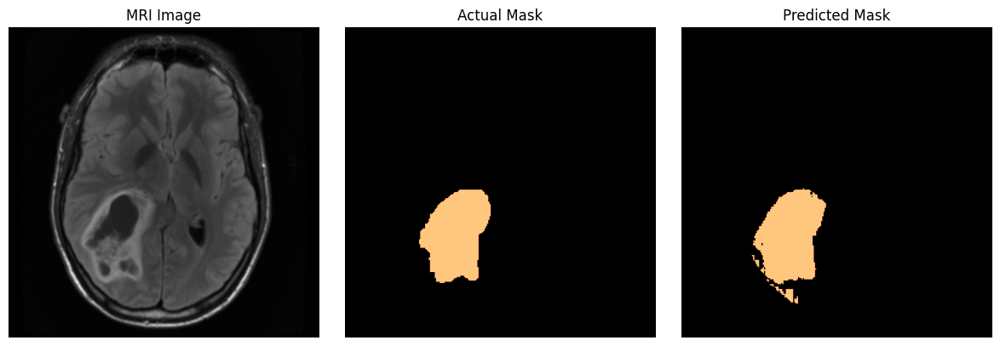

IoU: tensor([[0.1036]])


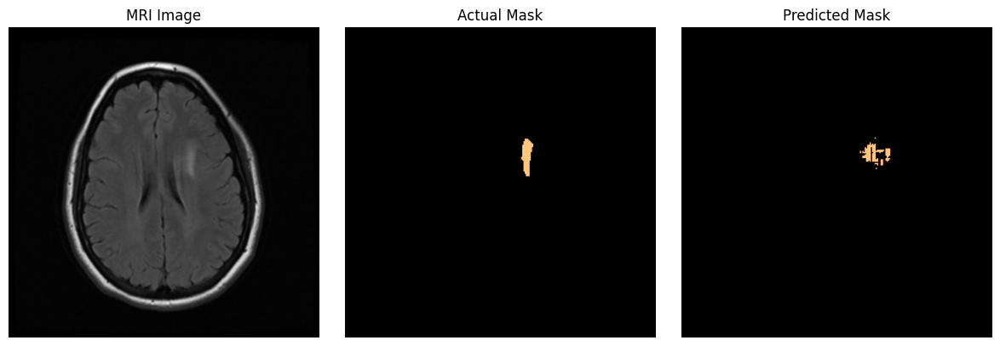

IoU: tensor([[0.6900]])


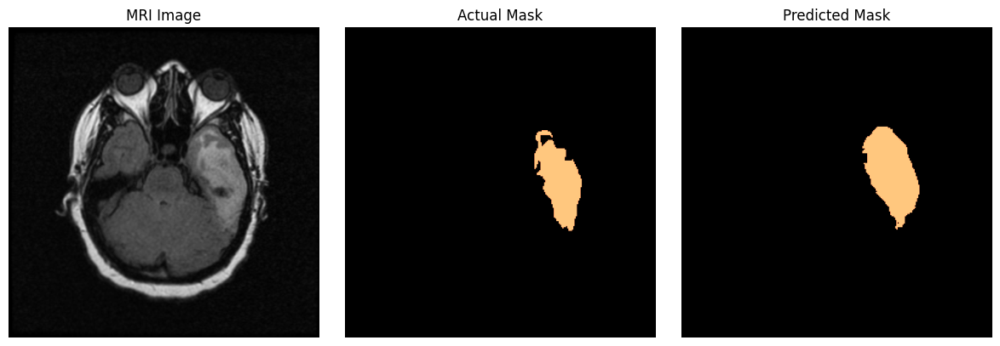

IoU: tensor([[0.8138]])


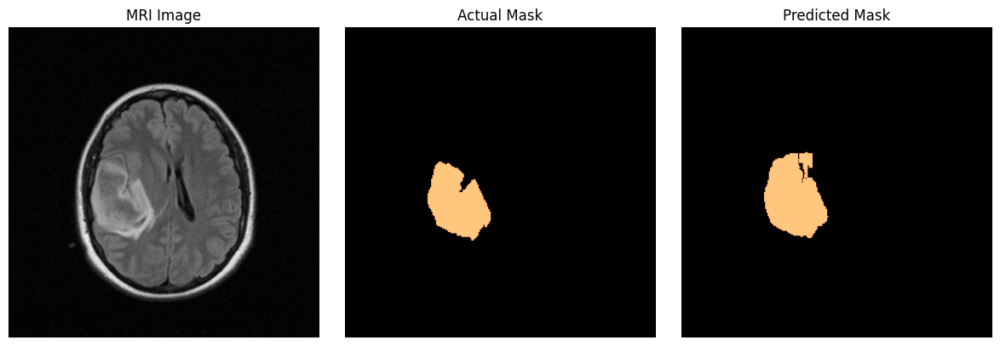

IoU: tensor([[0.6863]])


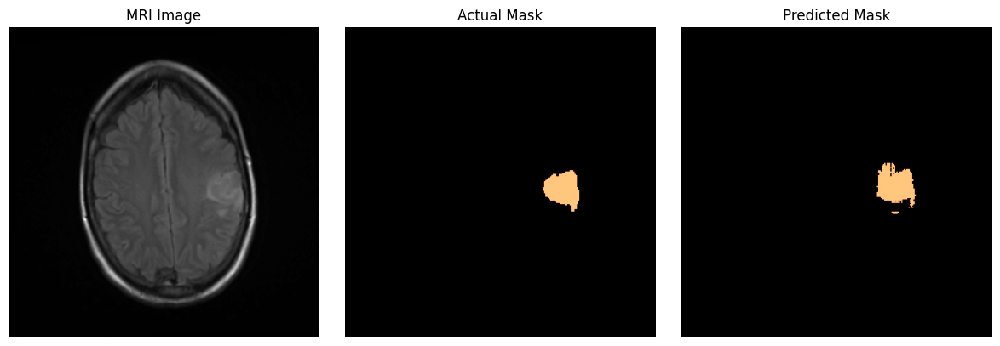

IoU: tensor([[0.4106]])


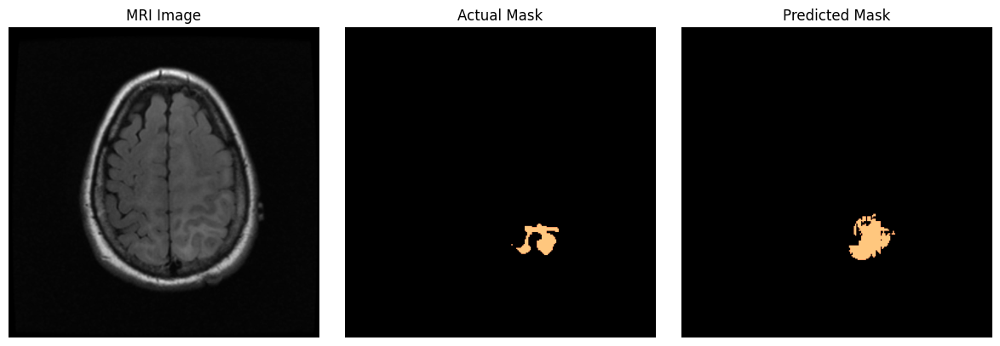

IoU: tensor([[0.8624]])


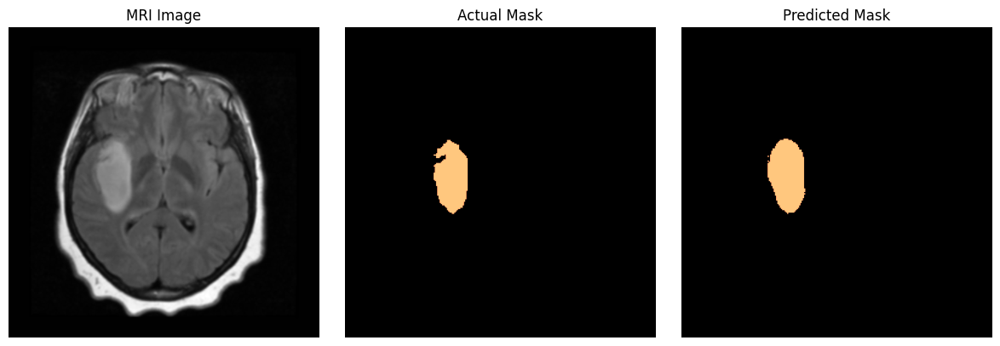

IoU: tensor([[0.8249]])


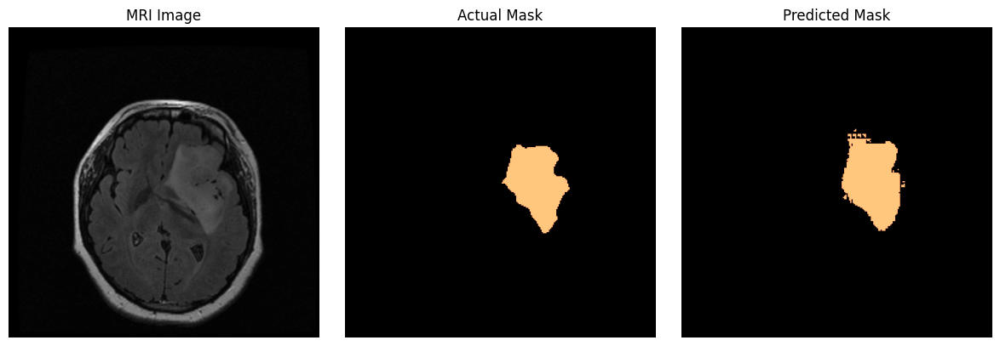

IoU: tensor([[0.9266]])


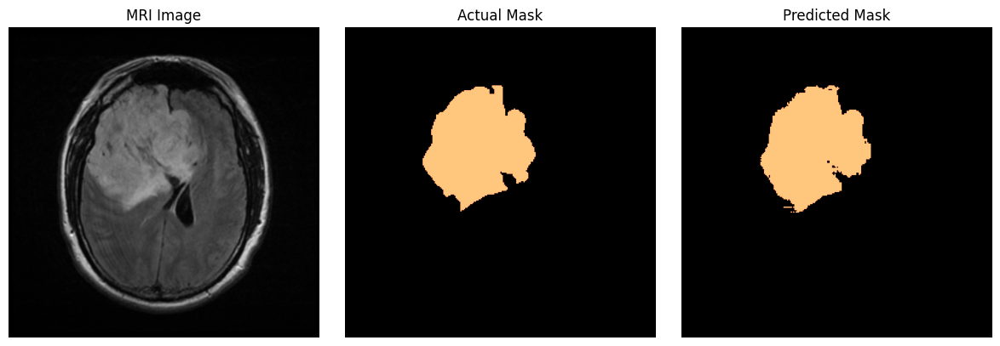

IoU: tensor([[0.7378]])


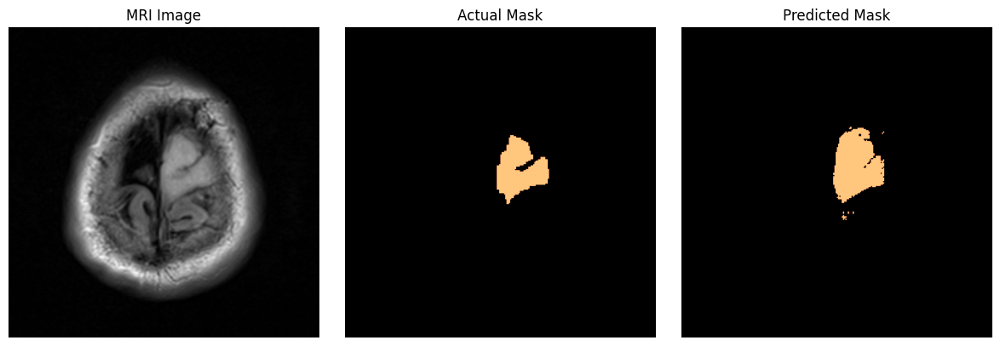

IoU: tensor([[0.3547]])


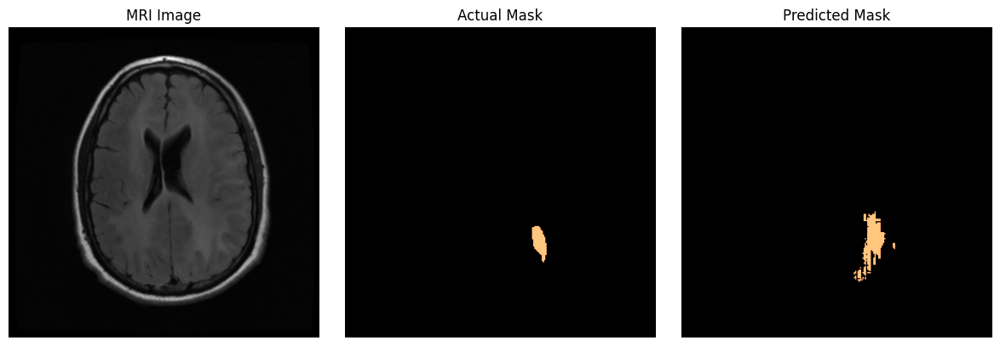

IoU: tensor([[0.8886]])


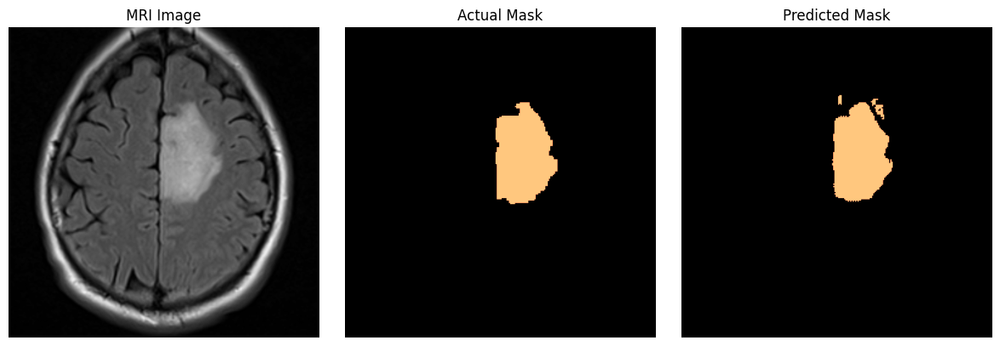

IoU: tensor([[0.8190]])


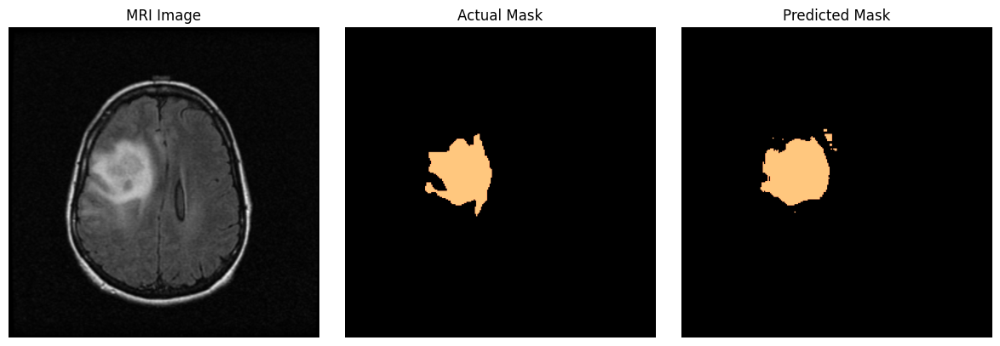

IoU: tensor([[0.6260]])


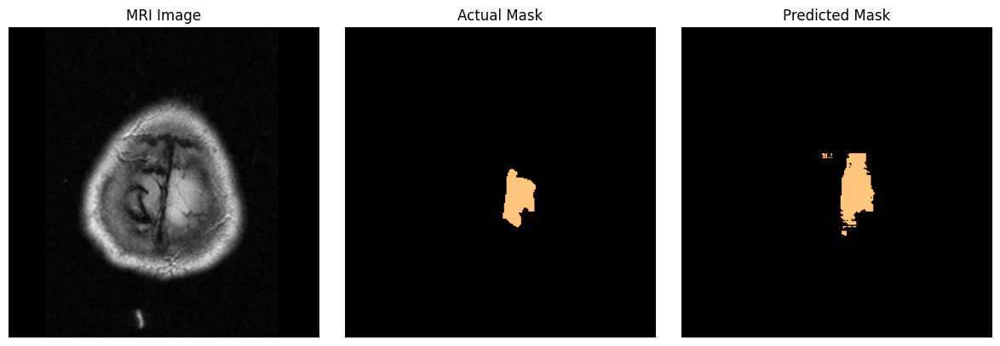

IoU: tensor([[0.9152]])


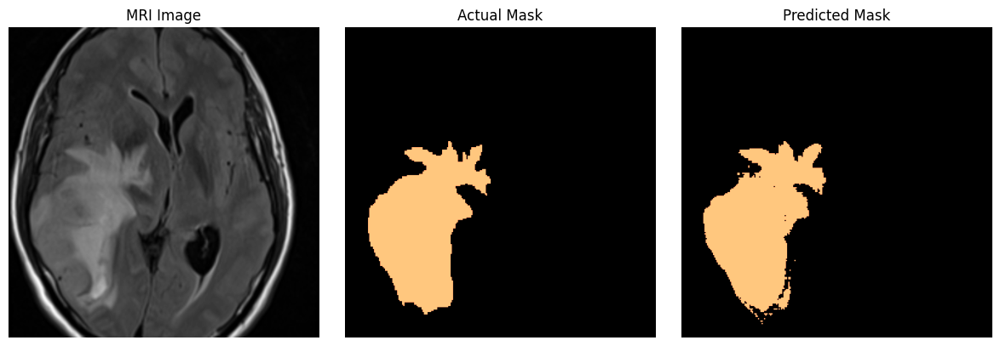

IoU: tensor([[0.3494]])


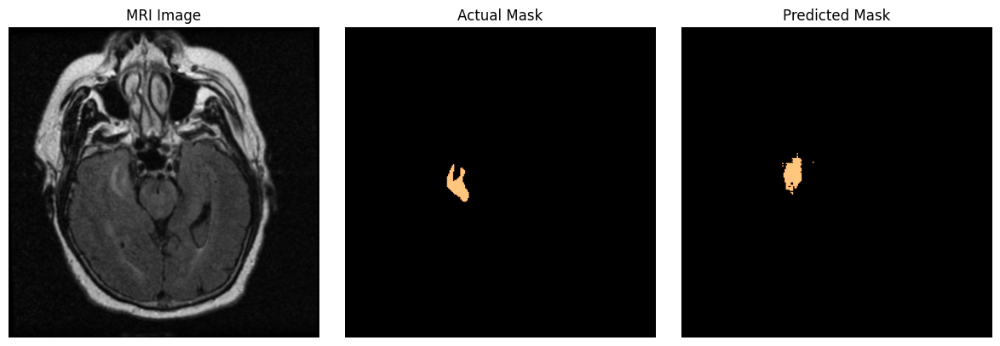

IoU: tensor([[0.8693]])


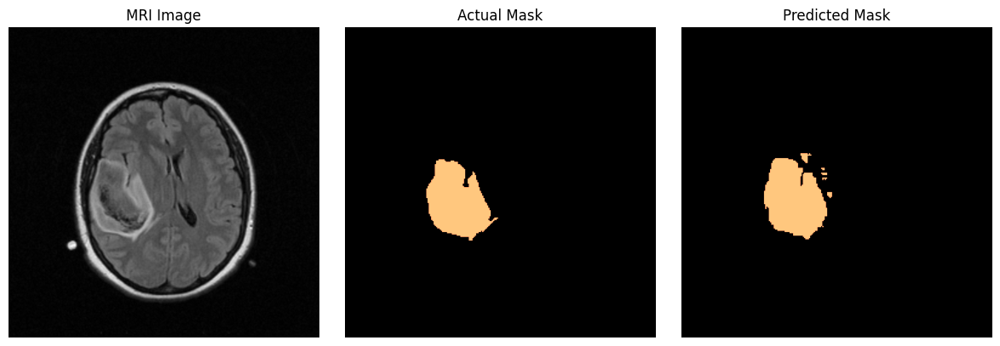

IoU: tensor([[0.8834]])


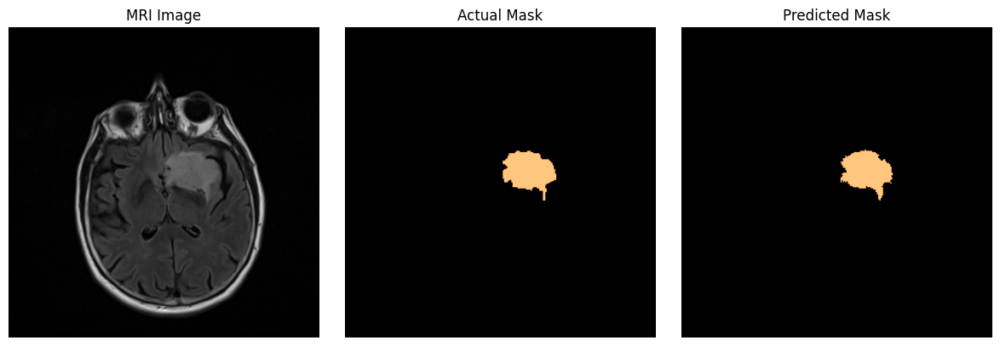

IoU: tensor([[0.8828]])


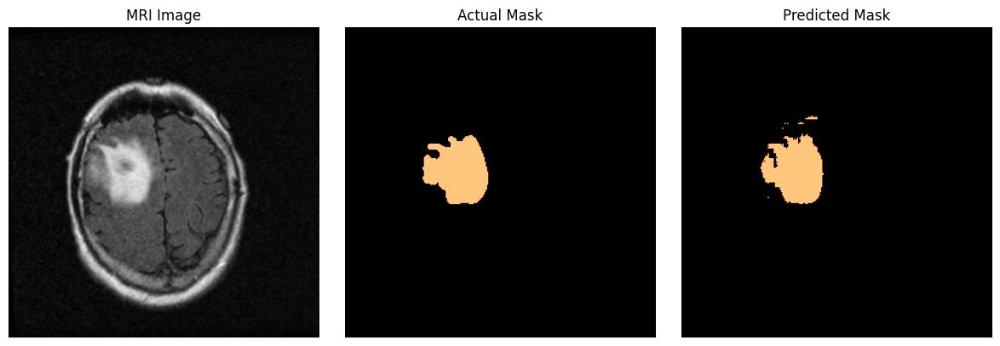

IoU: tensor([[0.8218]])


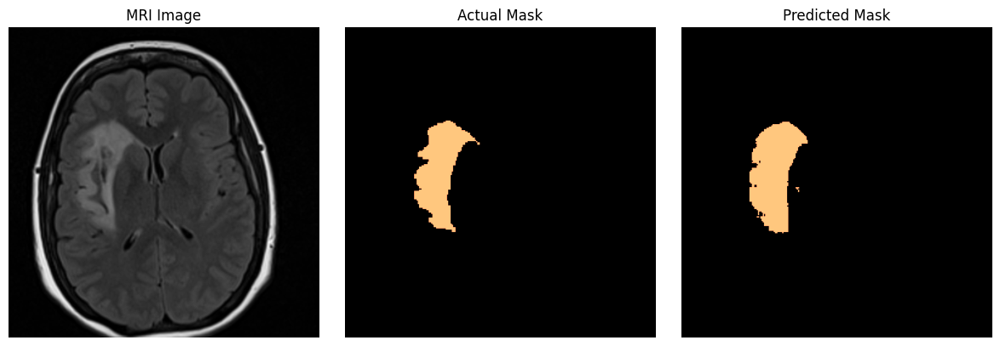

IoU: tensor([[0.0180]])


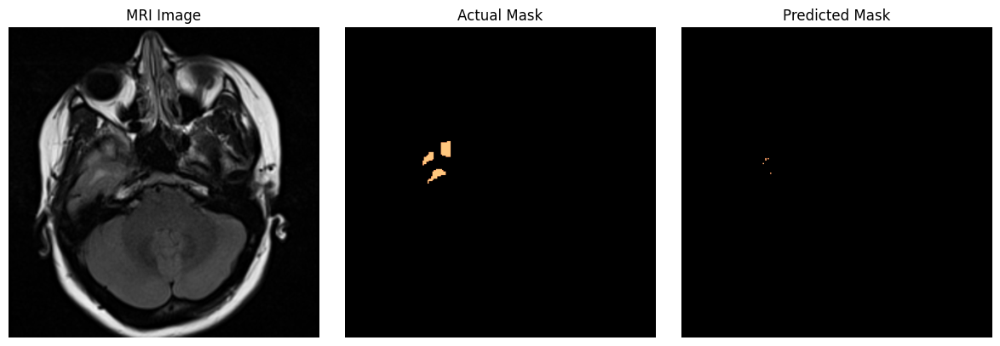

IoU: tensor([[0.7694]])


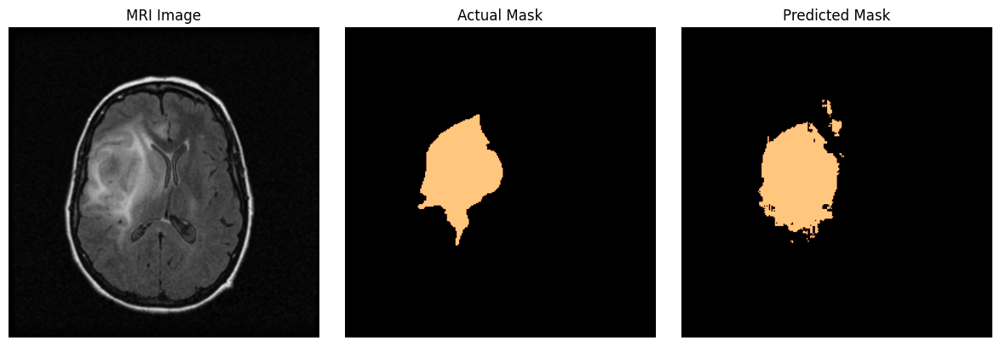

IoU: tensor([[0.7486]])


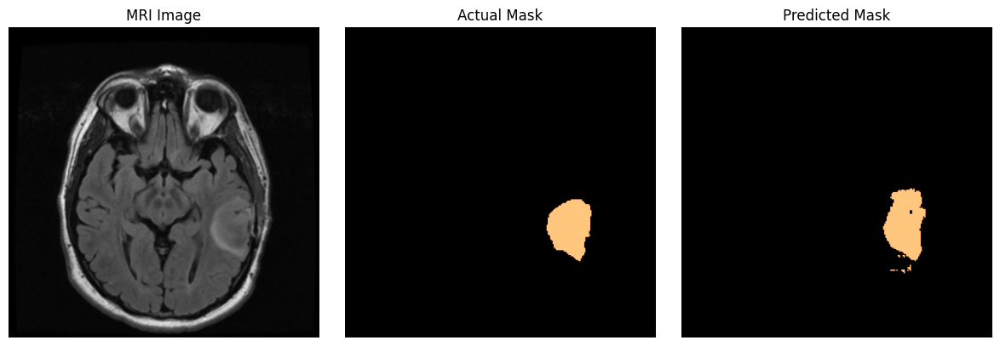

IoU: tensor([[0.5349]])


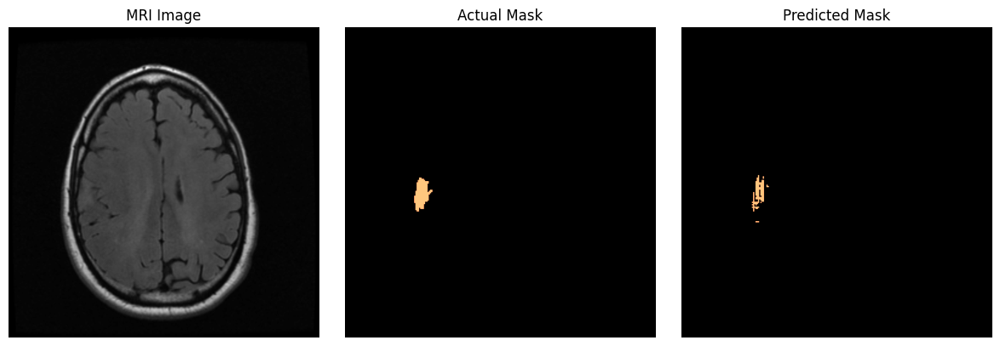

IoU: tensor([[0.3618]])


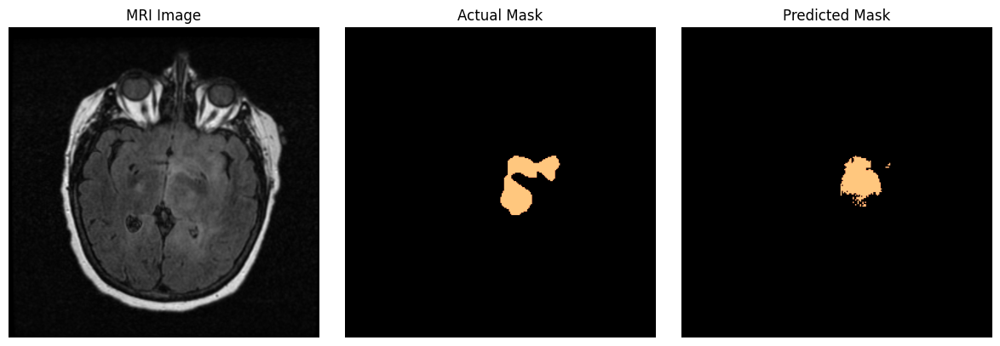

IoU: tensor([[0.8676]])


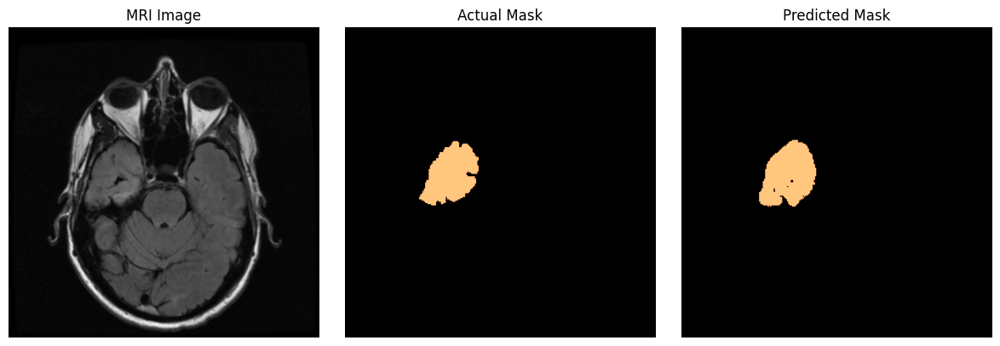

IoU: tensor([[0.5219]])


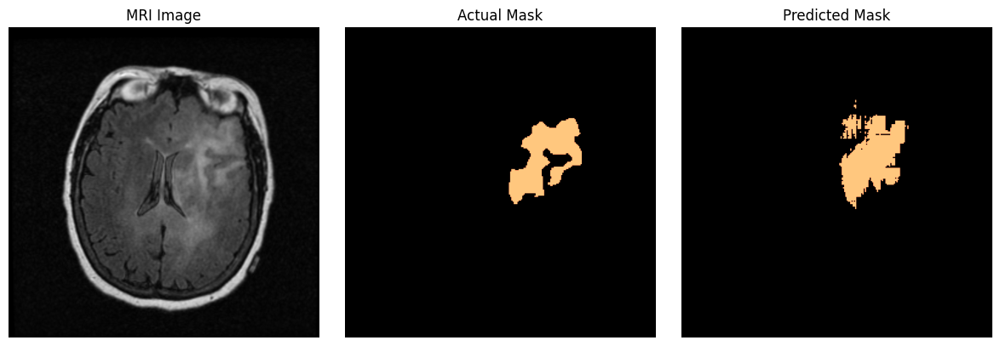

IoU: tensor([[0.6792]])


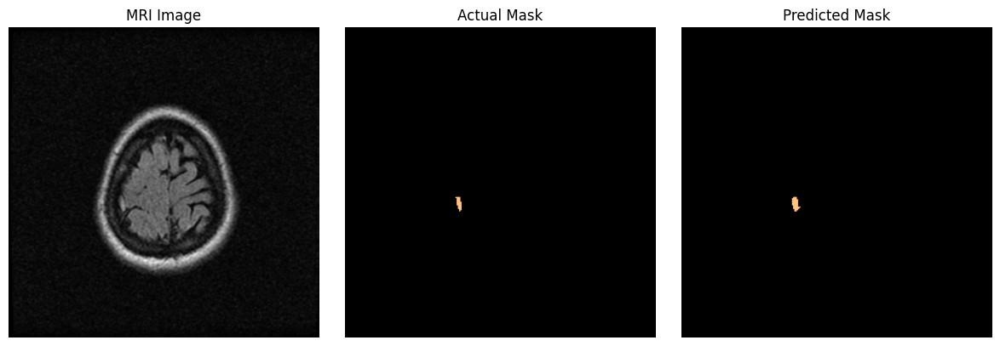

IoU: tensor([[0.8952]])


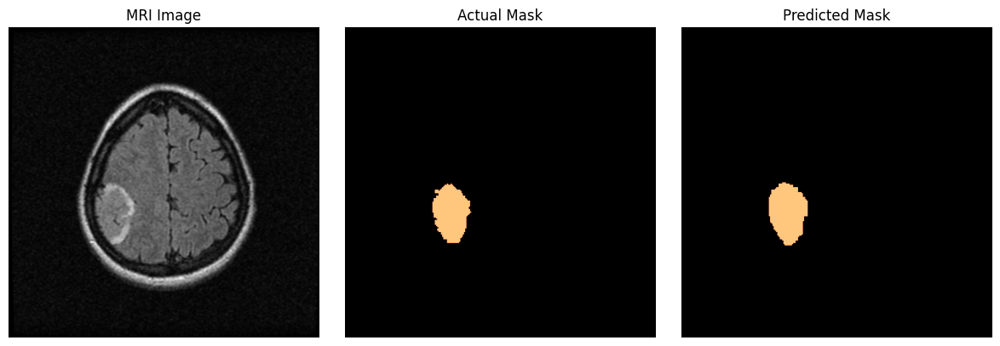

IoU: tensor([[0.8578]])


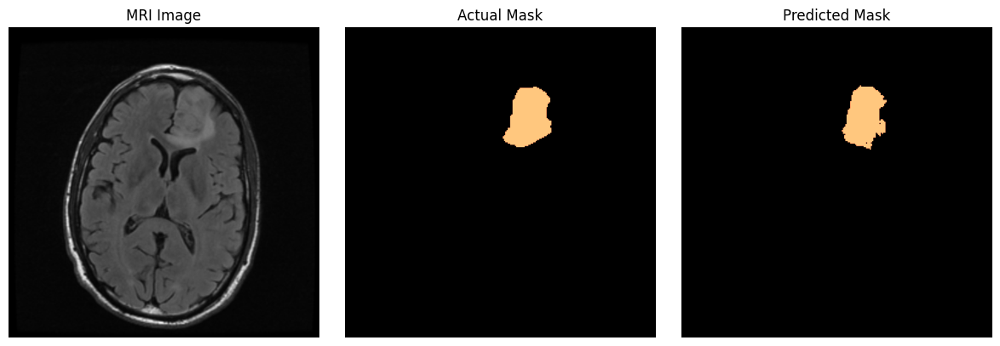

IoU: tensor([[0.6546]])


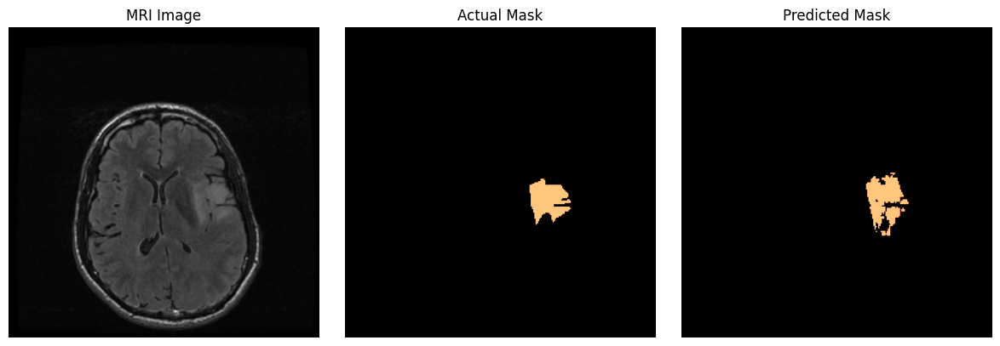

IoU: tensor([[0.5561]])


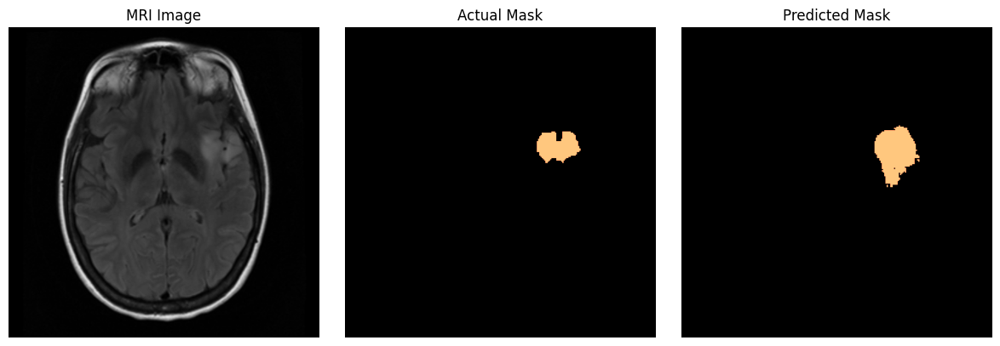

IoU: tensor([[0.8699]])


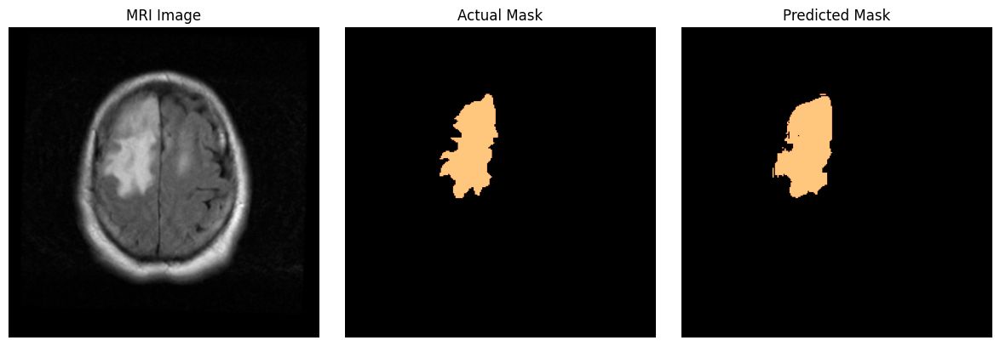

IoU: tensor([[0.7463]])


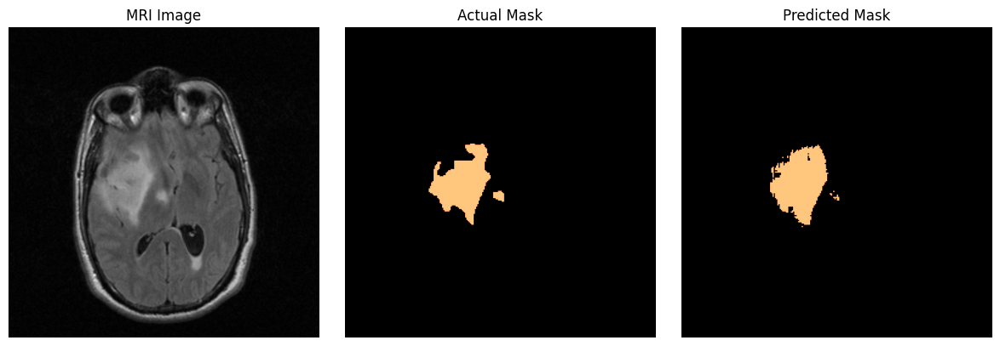

IoU: tensor([[0.5109]])


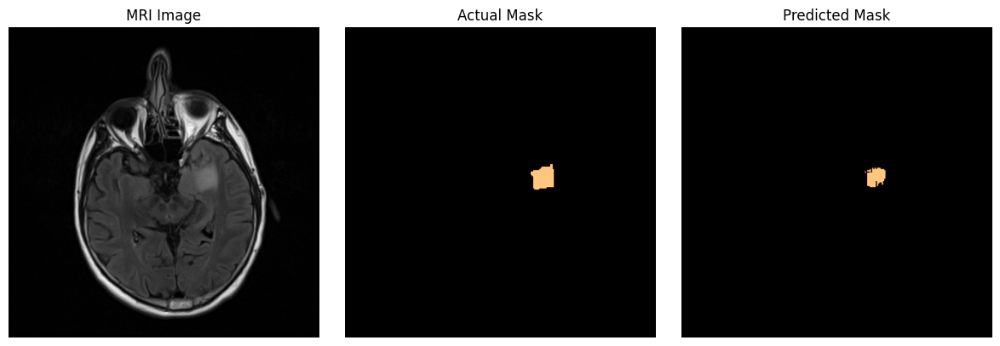

IoU: tensor([[0.9094]])


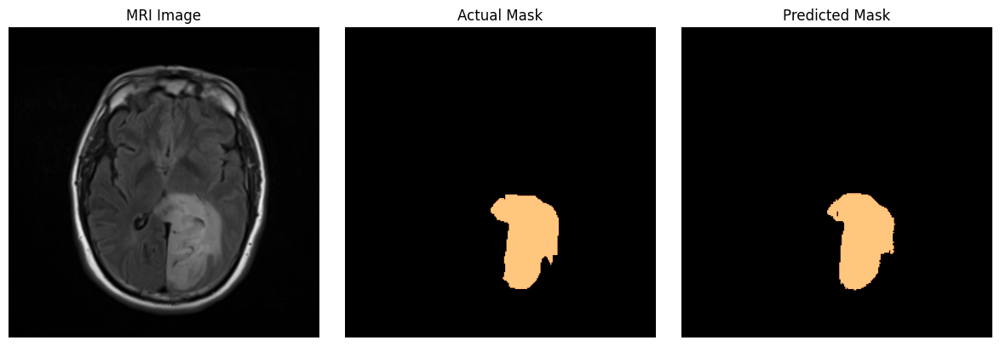

IoU: tensor([[0.7454]])


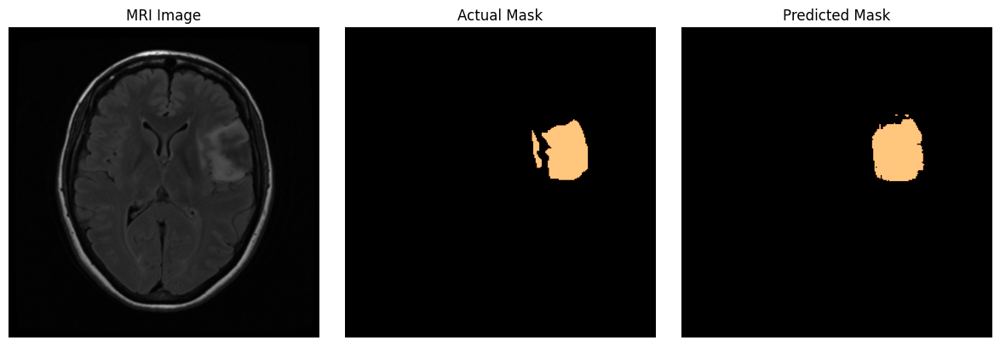

IoU: tensor([[0.6832]])


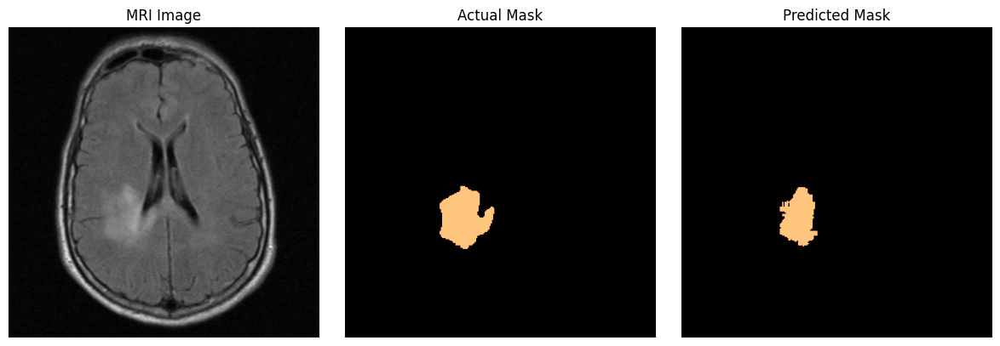

IoU: tensor([[0.8050]])


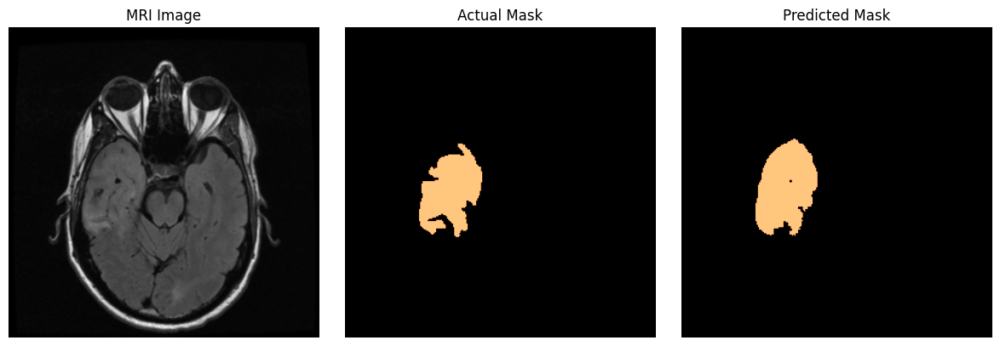

IoU: tensor([[0.9066]])


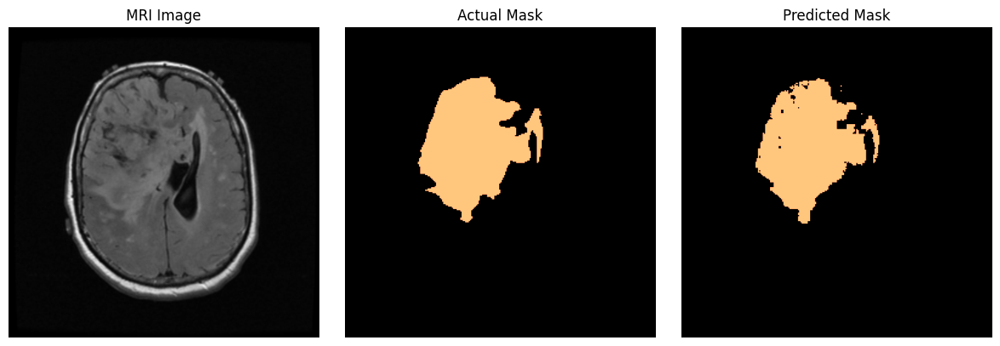

IoU: tensor([[0.3255]])


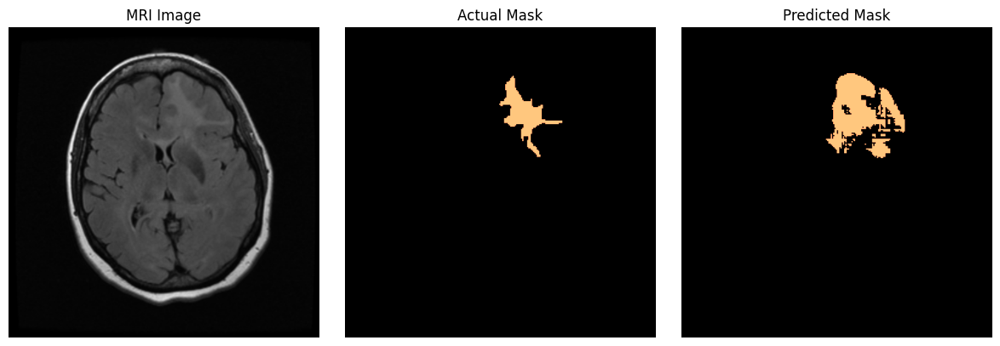

IoU: tensor([[0.2697]])


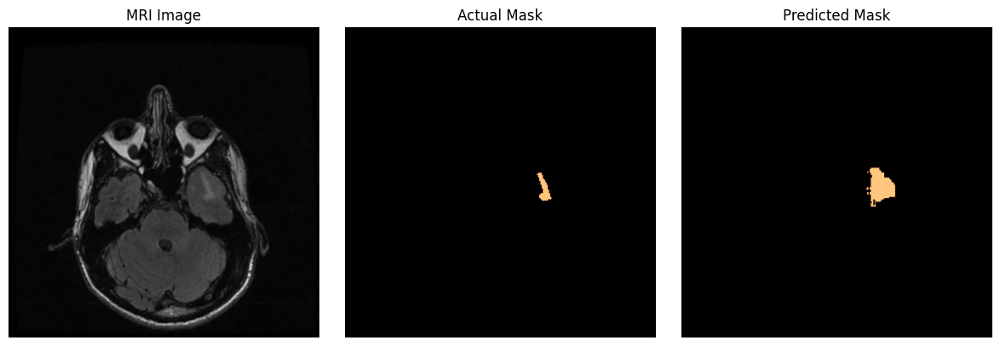

IoU: tensor([[0.3691]])


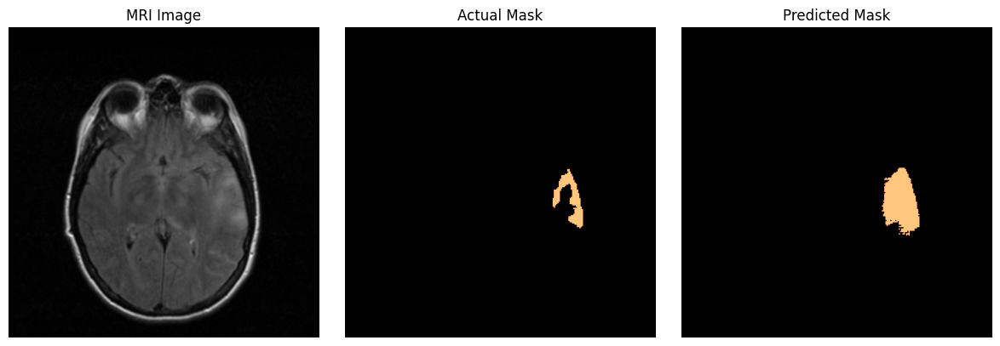

IoU: tensor([[0.5084]])


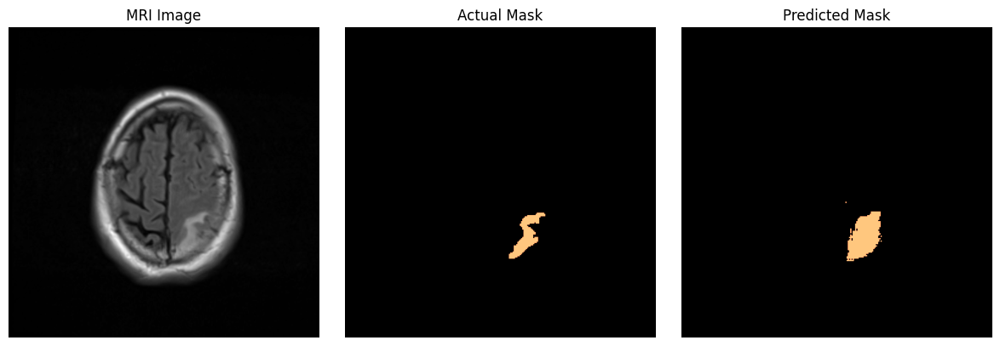

IoU: tensor([[0.7122]])


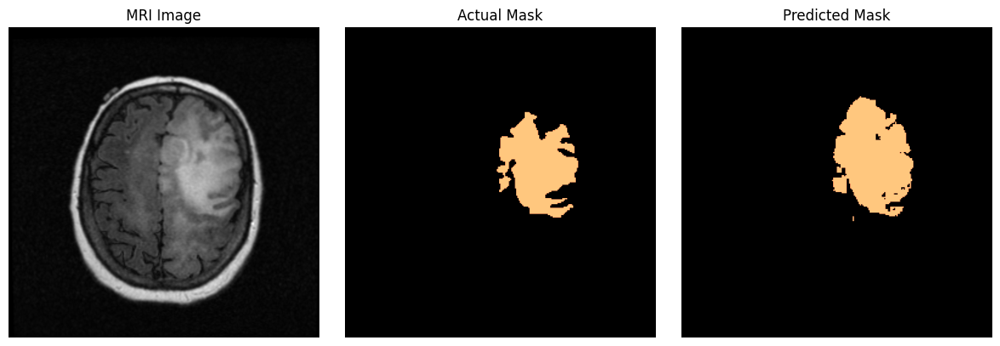

IoU: tensor([[0.6412]])


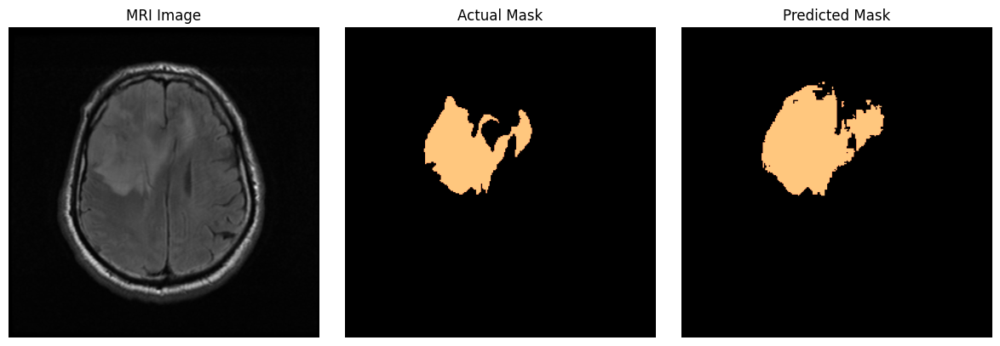

IoU: tensor([[0.8754]])


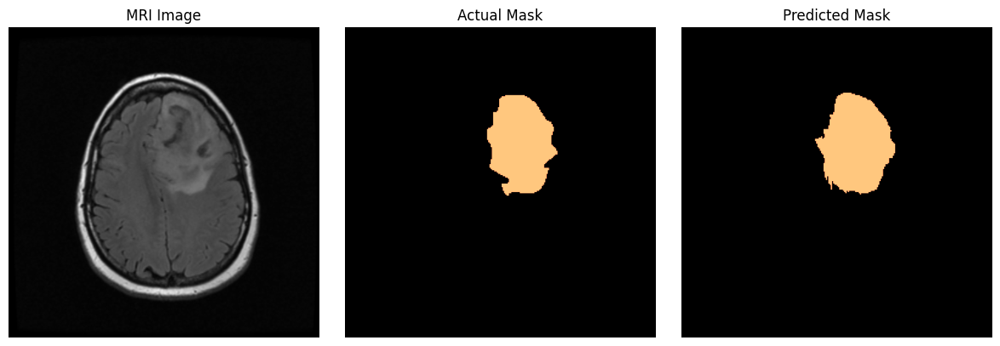

IoU: tensor([[0.5427]])


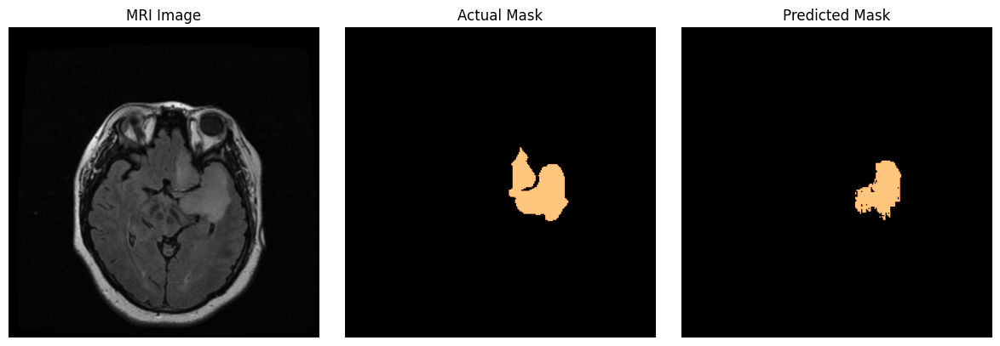

IoU: tensor([[0.5561]])


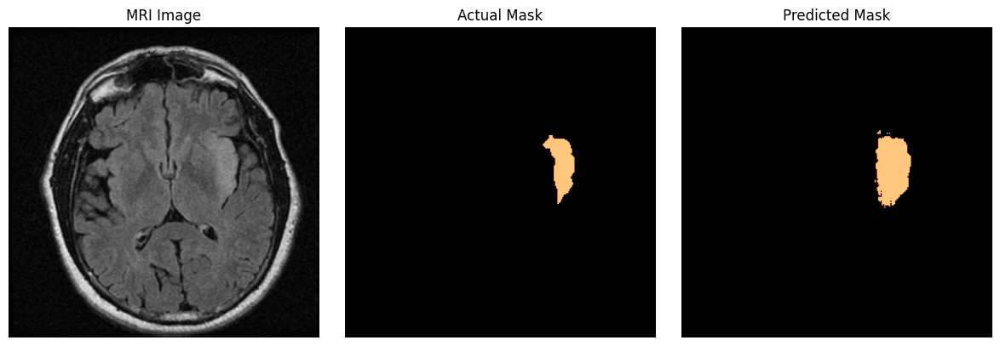

IoU: tensor([[0.8815]])


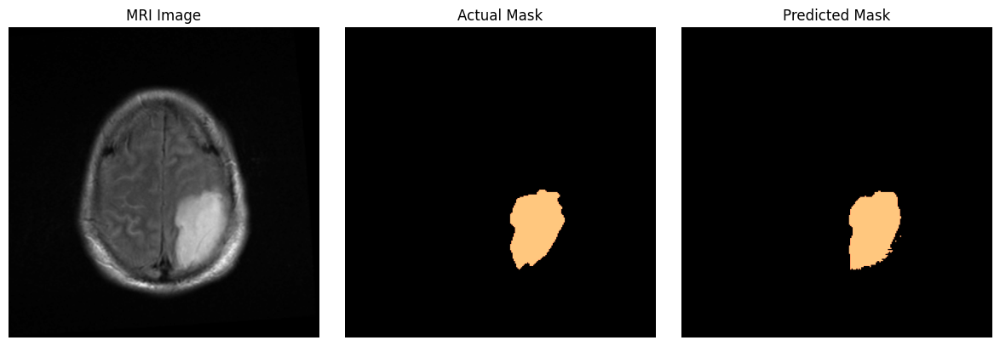

IoU: tensor([[0.5672]])


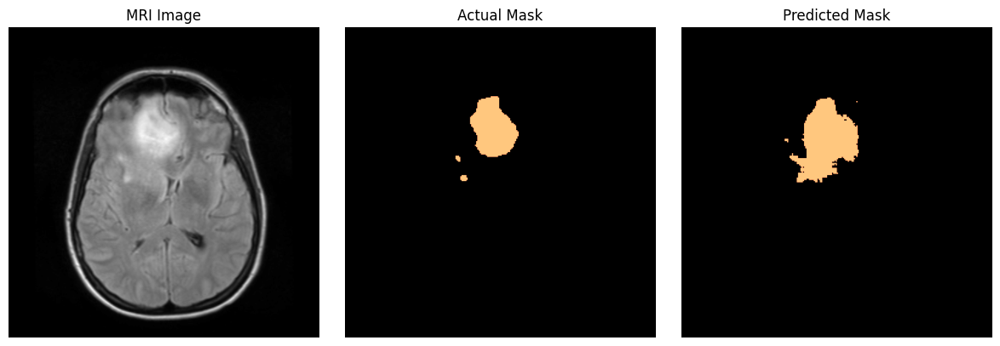

IoU: tensor([[0.9212]])


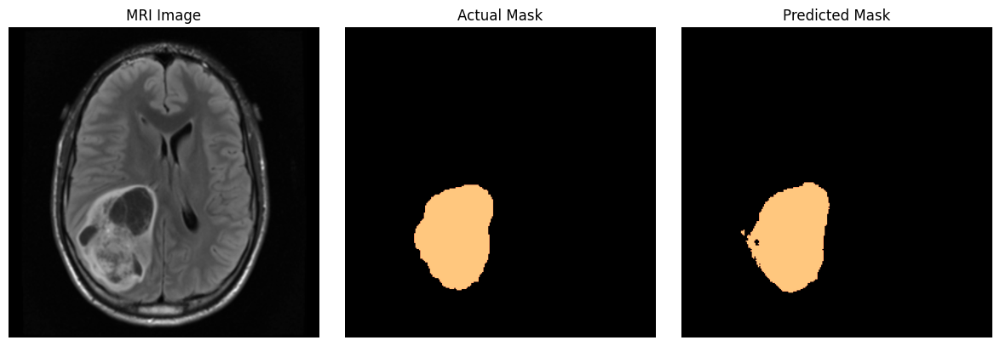

IoU: tensor([[0.7226]])


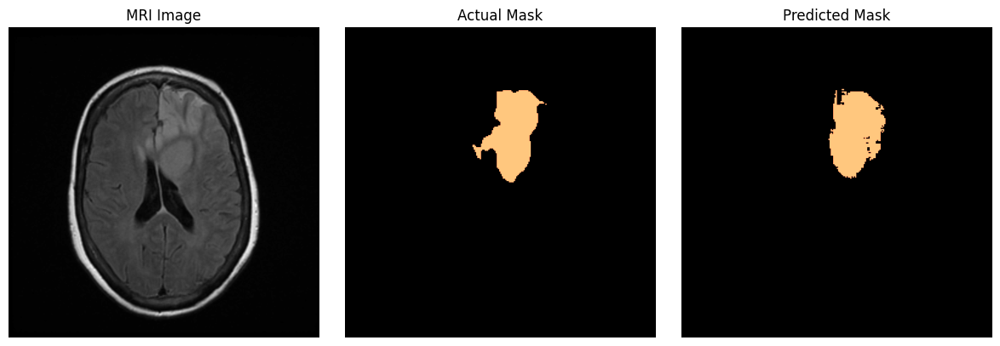

IoU: tensor([[0.8965]])


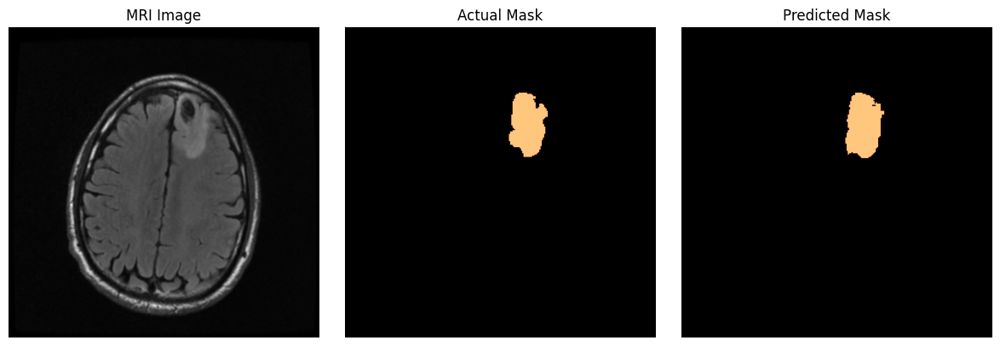

IoU: tensor([[0.7425]])


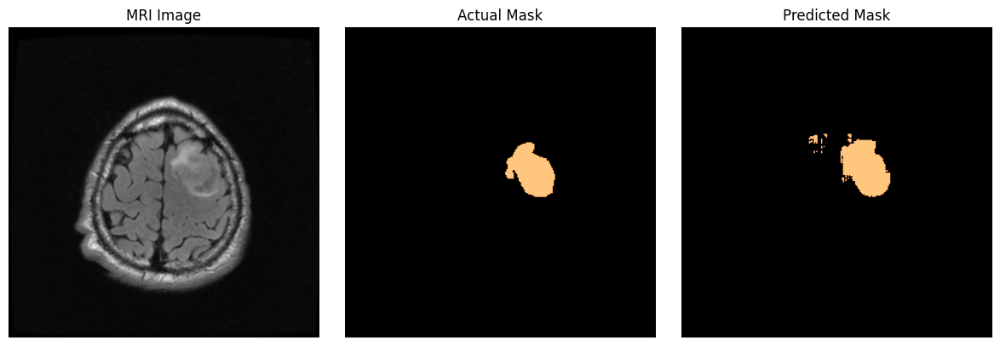

IoU: tensor([[0.7627]])


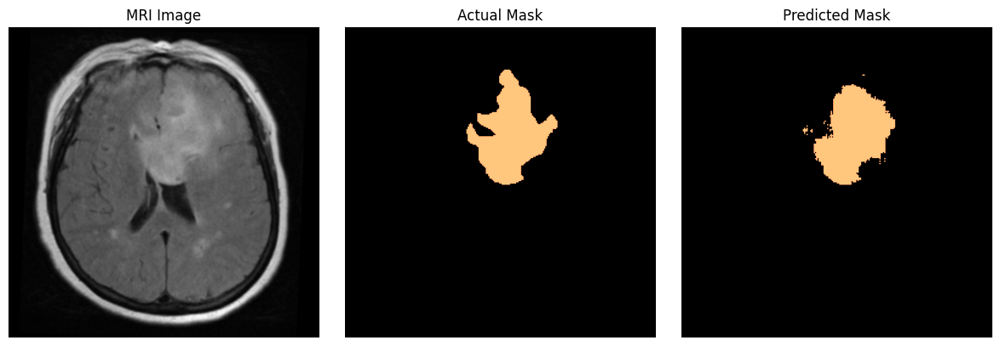

IoU: tensor([[0.7602]])


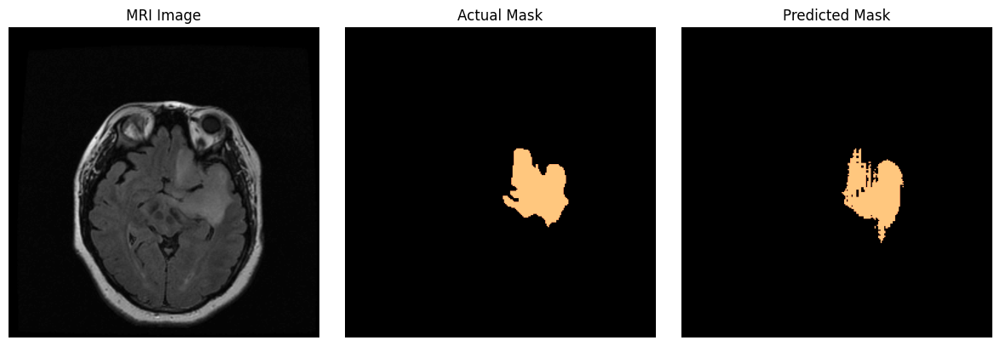

IoU: tensor([[0.8311]])


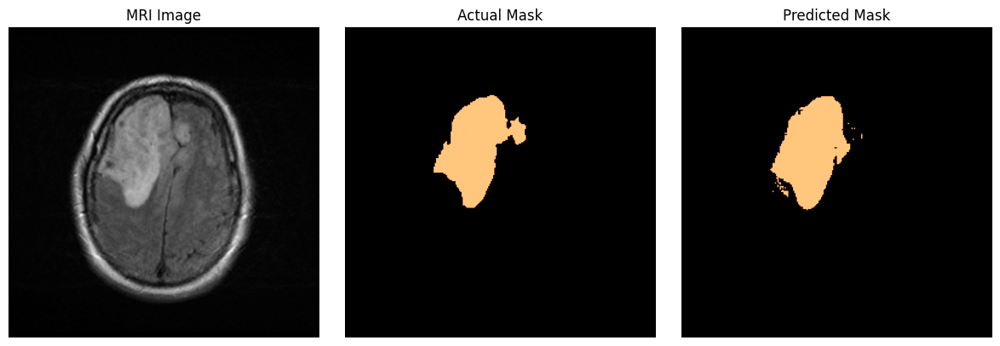

IoU: tensor([[0.4358]])


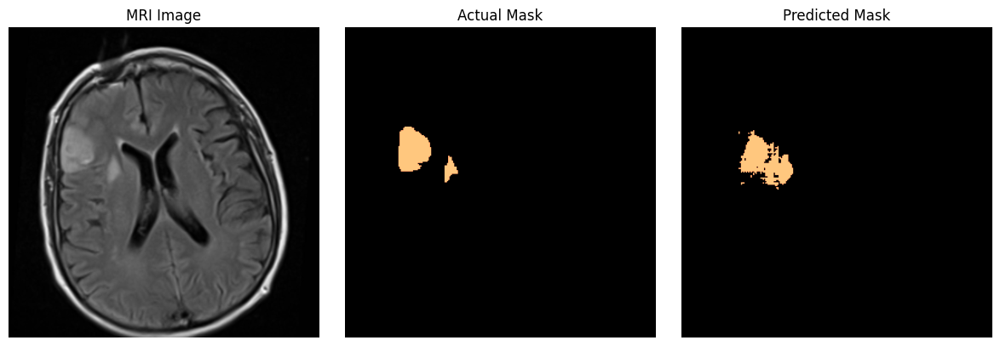

IoU: tensor([[0.8666]])


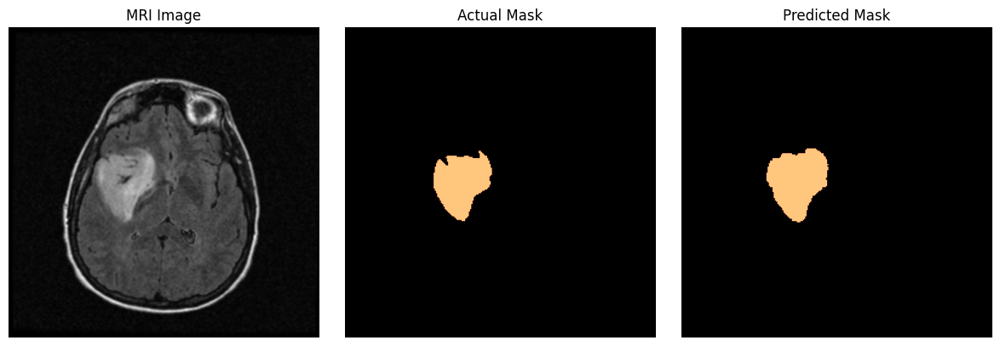

IoU: tensor([[0.6856]])


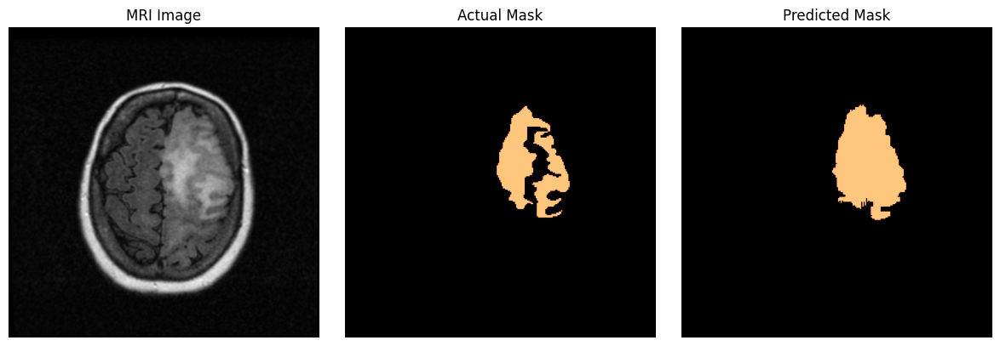

IoU: tensor([[0.9029]])


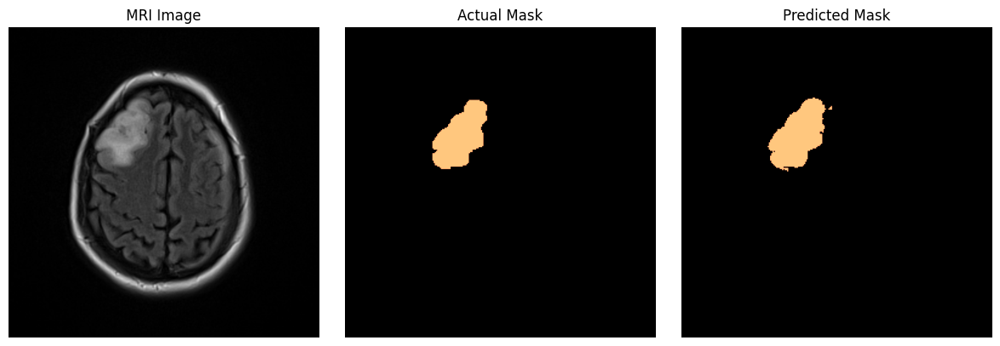

IoU: tensor([[0.5497]])


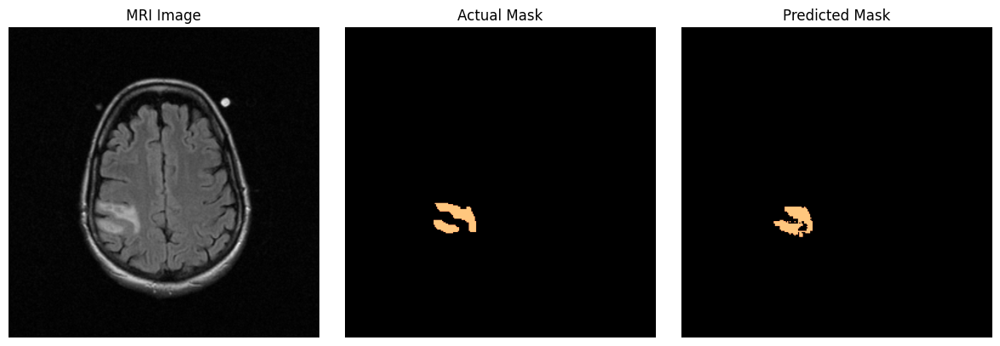

IoU: tensor([[0.7097]])


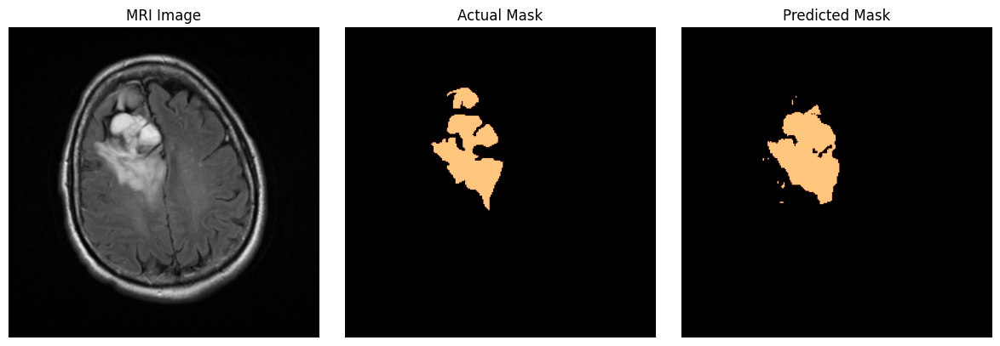

IoU: tensor([[0.4927]])


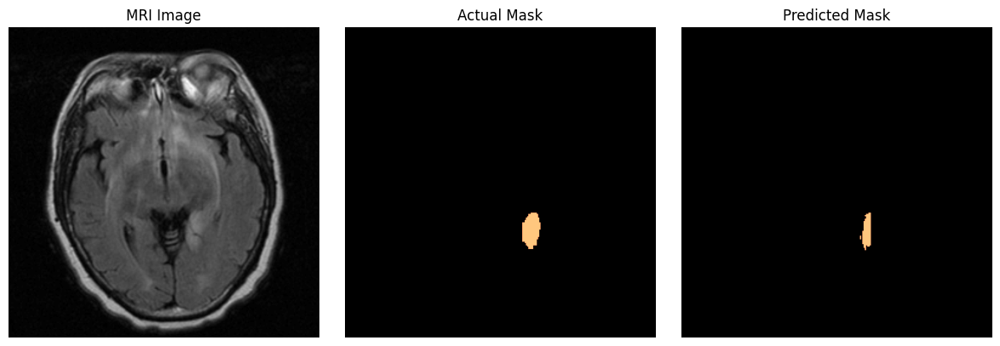

IoU: tensor([[0.8243]])


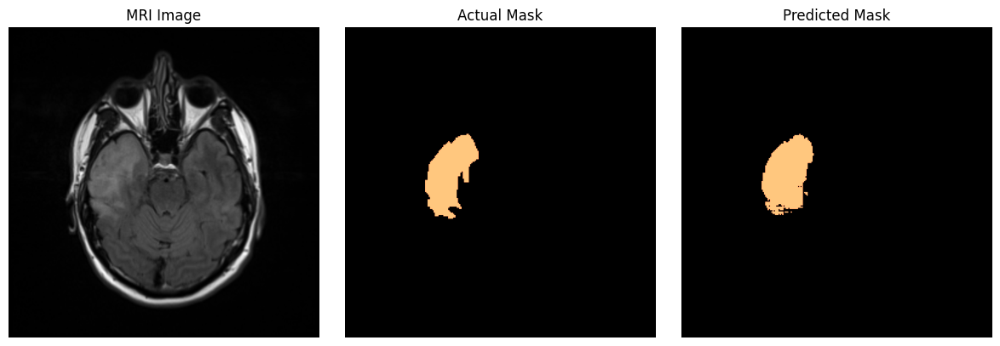

IoU: tensor([[0.8964]])


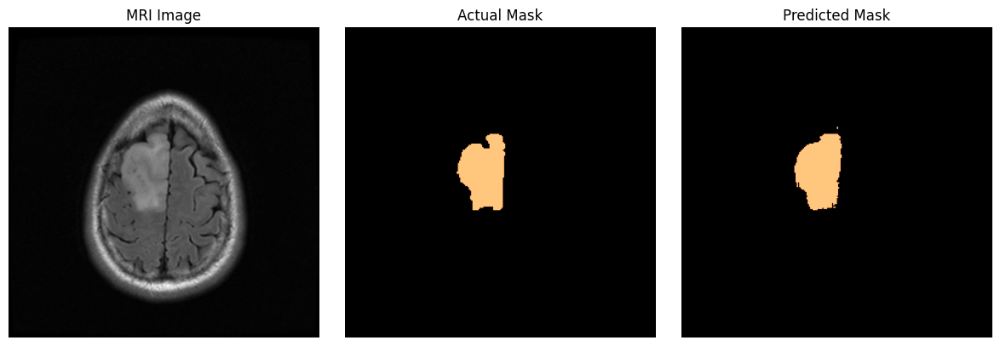

IoU: tensor([[0.9114]])


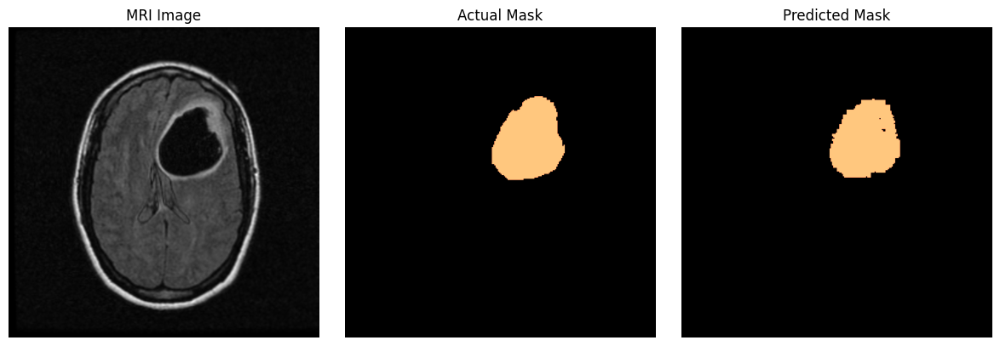

IoU: tensor([[0.7885]])


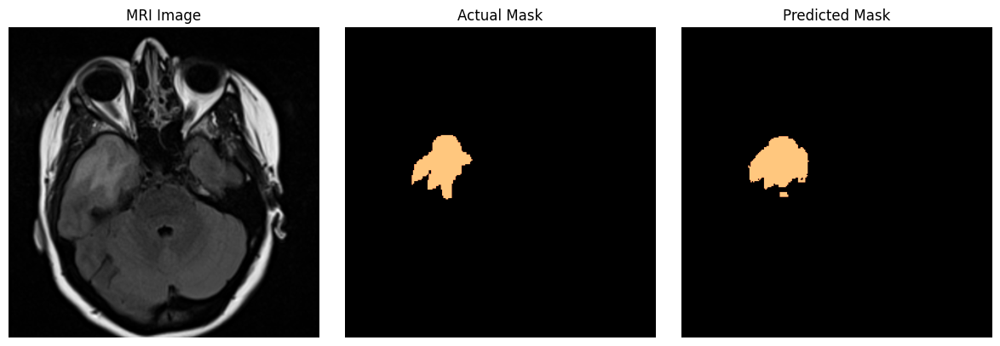

IoU: tensor([[0.9236]])


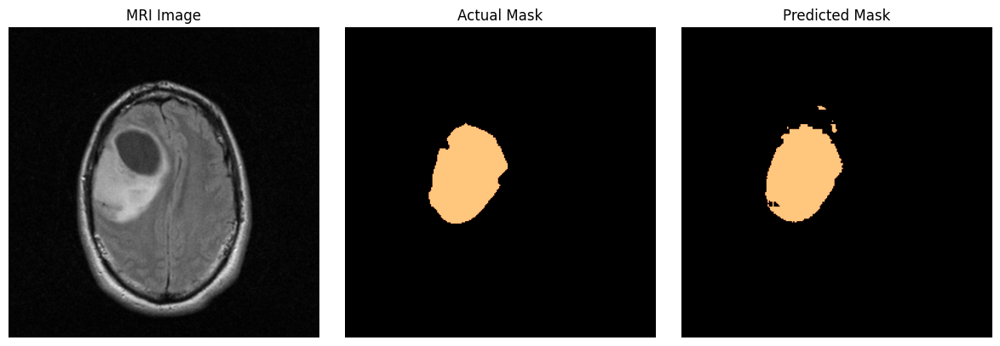

IoU: tensor([[0.9489]])


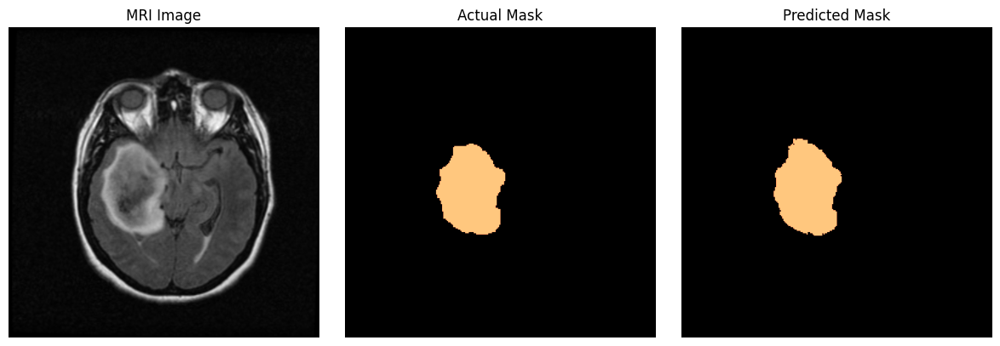

IoU: tensor([[0.2661]])


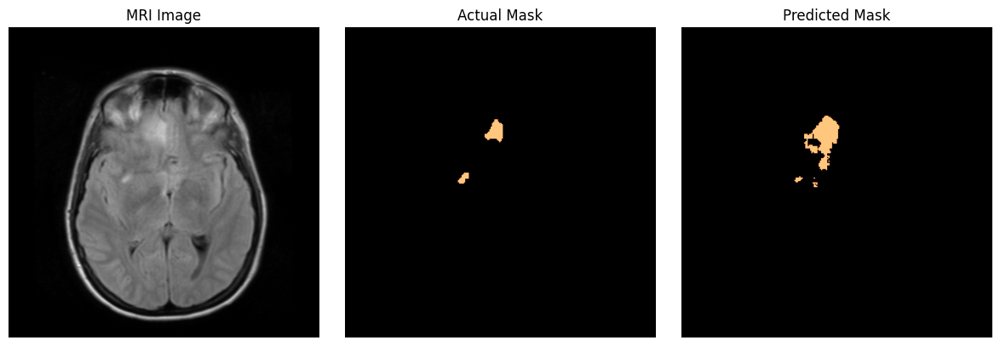

IoU: tensor([[0.5702]])


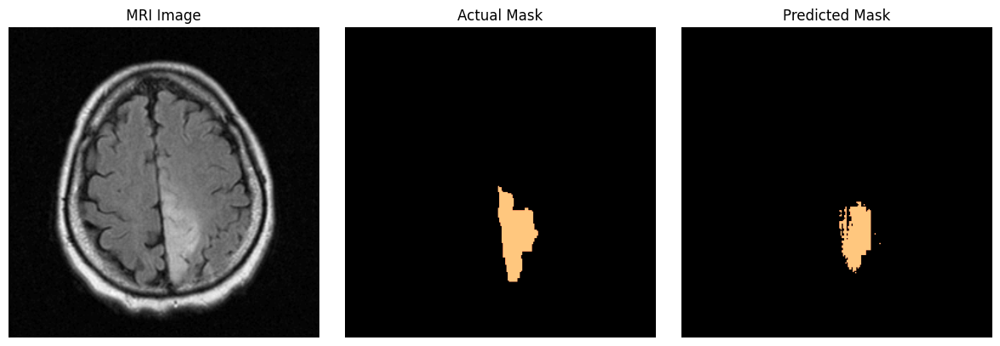

IoU: tensor([[0.9227]])


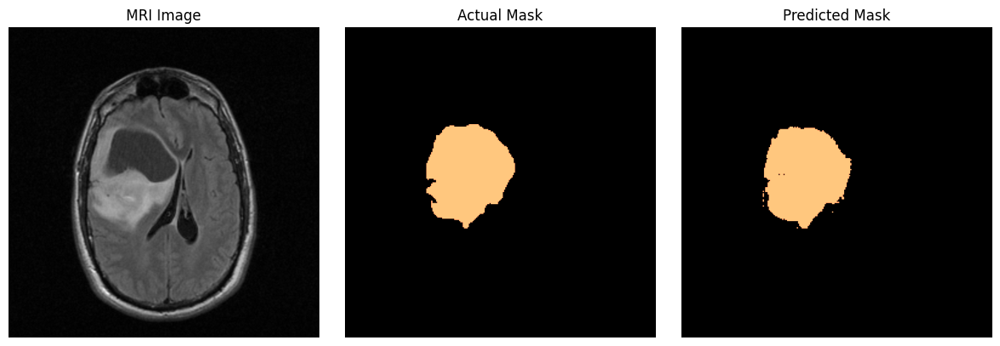

IoU: tensor([[0.6999]])


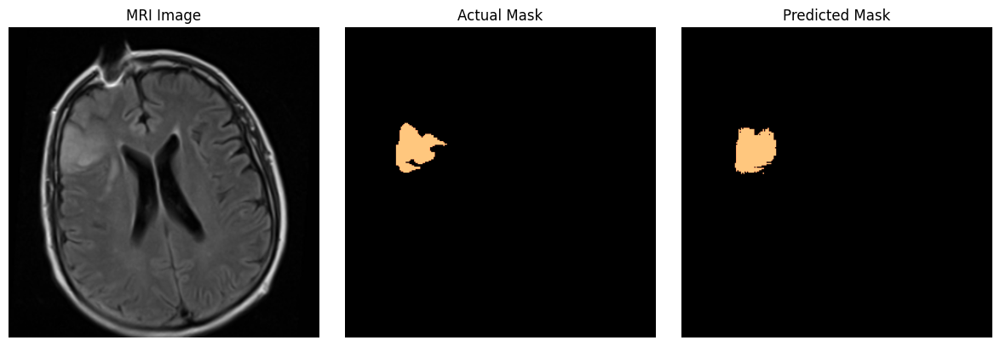

IoU: tensor([[0.2988]])


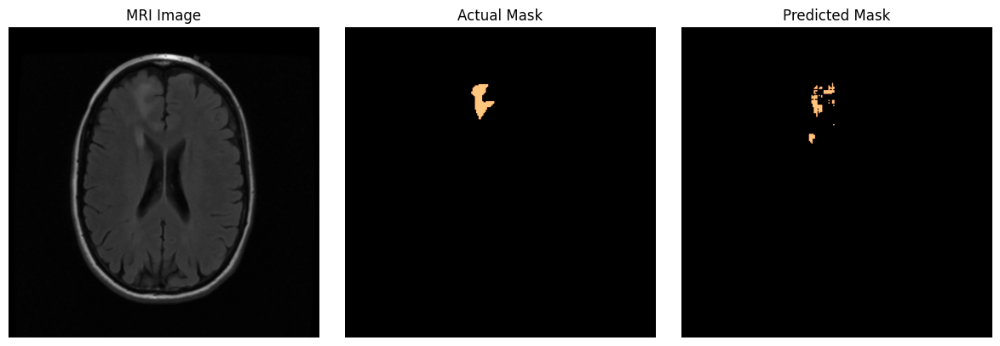

IoU: tensor([[0.9200]])


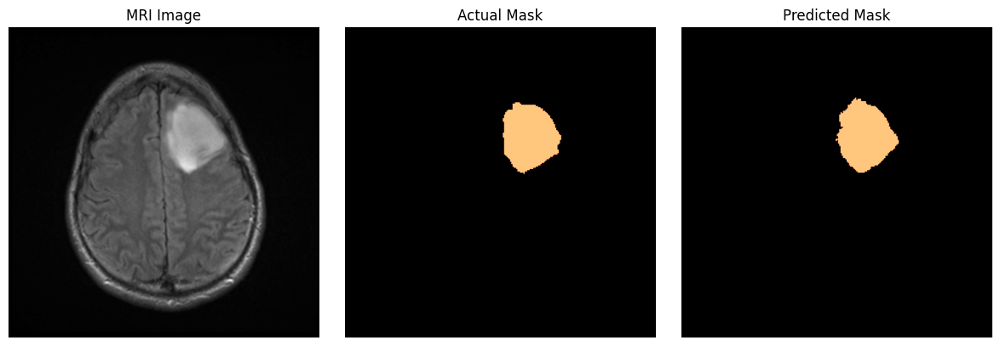

IoU: tensor([[0.3718]])


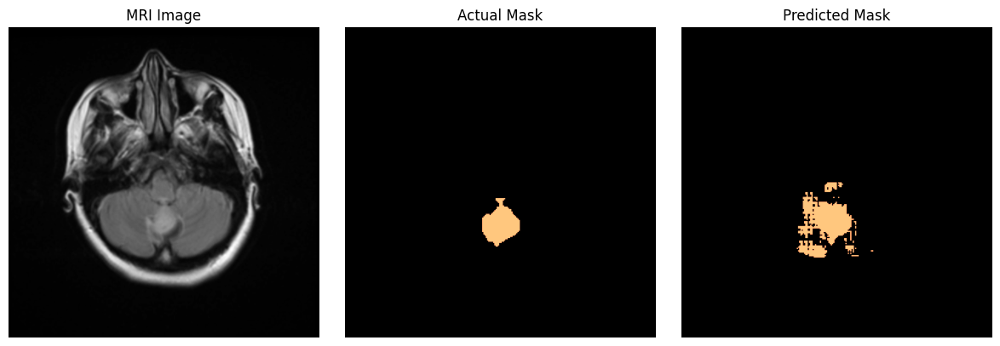

IoU: tensor([[0.5646]])


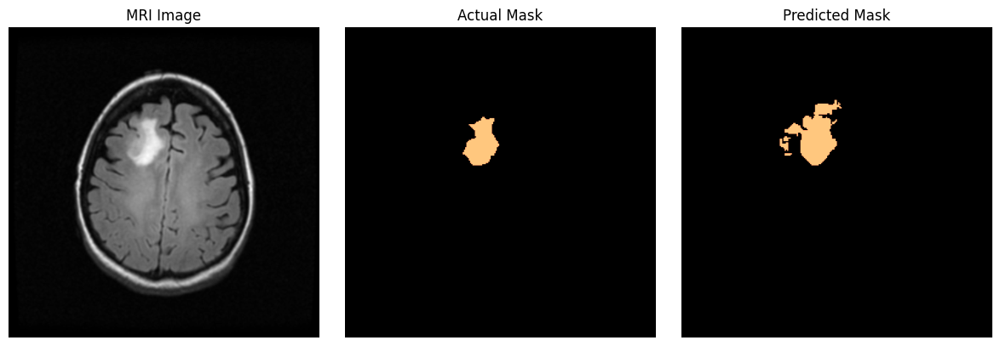

In [59]:
test_ious = []
model.eval()
# Iteratire through test images
with torch.no_grad():
    for batch in tqdm(test_dataloader):

        # forward pass
        outputs = model(pixel_values=batch["pixel_values"].cuda(),
                      input_boxes=batch["input_boxes"].cuda(),
                      multimask_output=False)

        ground_truth_masks = batch["ground_truth_mask"].float().cuda()

        # apply sigmoid
        sam_mask_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
        sam_mask_prob = sam_mask_prob.cpu().numpy().squeeze()
        sam_mask = (sam_mask_prob > 0.5)

        iou = compute_iou(torch.from_numpy(sam_mask).reshape(1, 256, 256).unsqueeze(1).cpu(),
                          ground_truth_masks.unsqueeze(1).cpu(), ignore_empty=False)

        print(f'IoU: {iou}')
        test_ious.append(iou)

        plt.figure(figsize=(12,4))
        plt.subplot(1,3,1)
        plt.imshow(batch["pixel_values"][0,1], cmap='gray')
        plt.title('MRI Image')
        plt.axis('off')

        plt.subplot(1,3,2)
        plt.imshow(batch["ground_truth_mask"][0], cmap='copper')
        plt.title('Actual Mask')
        plt.axis('off')

        plt.subplot(1,3,3)
        plt.imshow(sam_mask, cmap='copper')
        plt.title('Predicted Mask')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

## Inference with Known Bounding Box

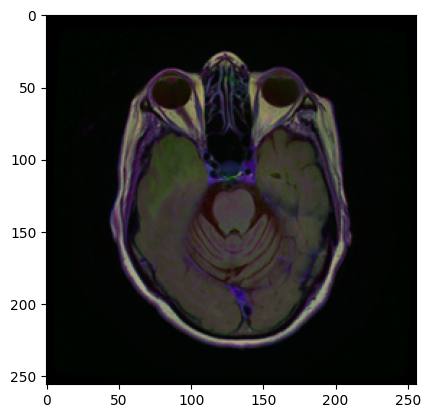

In [60]:
idx = 10
image = test_dataset[idx]["image"]
plt.imshow(np.array(image))

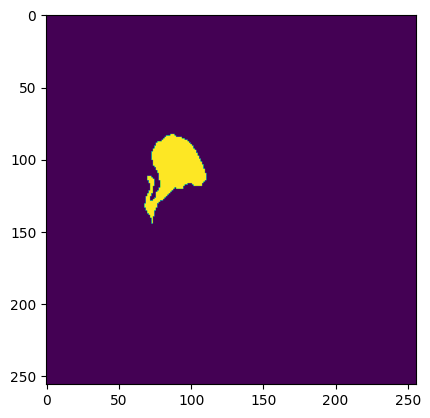

In [61]:
plt.imshow(np.array(test_dataset[idx]["mask"]))

In [62]:
ground_truth_mask = np.array(test_dataset[idx]["mask"])
prompt = get_bounding_box(ground_truth_mask)
inputs = processor(image, input_boxes=[[prompt]], return_tensors="pt").to(device)
for k,v in inputs.items():
  print(k,v.shape)

pixel_values torch.Size([1, 3, 1024, 1024])
original_sizes torch.Size([1, 2])
reshaped_input_sizes torch.Size([1, 2])
input_boxes torch.Size([1, 1, 4])


(-0.5, 255.5, 255.5, -0.5)

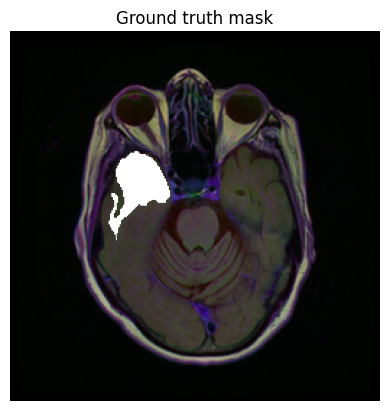

In [63]:
fig, axes = plt.subplots()

axes.imshow(np.array(image))
show_mask(ground_truth_mask, axes)
axes.title.set_text(f"Ground truth mask")
axes.axis("off")

In [64]:
model.eval()
with torch.no_grad():
  outputs = model(**inputs, multimask_output=False)

In [65]:
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5)

(-0.5, 255.5, 255.5, -0.5)

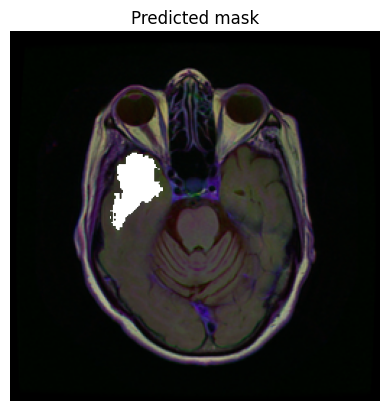

In [66]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([255, 255, 255, 255])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

fig, axes = plt.subplots()

axes.imshow(np.array(image))
show_mask(medsam_seg, axes)
axes.title.set_text(f"Predicted mask")
axes.axis("off")

In [67]:
predicted_masks = outputs.pred_masks.squeeze(1)
ground_truth_masks = batch["ground_truth_mask"].float().to(device)

sam_masks_prob = torch.sigmoid(predicted_masks)
sam_masks_prob = sam_masks_prob.squeeze()
sam_masks = (sam_masks_prob > 0.5)

In [68]:
pred = torch.from_numpy(medsam_seg).float()

In [69]:
act = torch.from_numpy(ground_truth_mask).float()

In [70]:
iou = compute_iou(act/255, pred)

iou

tensor(0.7366)

## Inference with Unknown Bounding Box

### Prompt: Grid of Points

In [71]:
array_size = 256
grid_size = 10
x = np.linspace(0, array_size-1, grid_size)
y = np.linspace(0, array_size-1, grid_size)
xv, yv = np.meshgrid(x, y)
xv_list = xv.tolist()
yv_list = yv.tolist()

input_points = [[[int(x), int(y)] for x, y in zip(x_row, y_row)] for x_row, y_row in zip(xv_list, yv_list)]
input_points = torch.tensor(input_points).view(1, 1, grid_size*grid_size, 2)

In [72]:
image = test_dataset[-1]["image"]
ground_truth_mask = np.array(test_dataset[-1]["mask"])

inputs = processor(image, input_points=input_points, return_tensors="pt").to(device)
for k,v in inputs.items():
  print(k,v.shape)

pixel_values torch.Size([1, 3, 1024, 1024])
original_sizes torch.Size([1, 2])
reshaped_input_sizes torch.Size([1, 2])
input_points torch.Size([1, 1, 100, 2])


In [73]:
model.eval()
with torch.no_grad():
  outputs = model(**inputs, multimask_output=False)

In [74]:
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5)

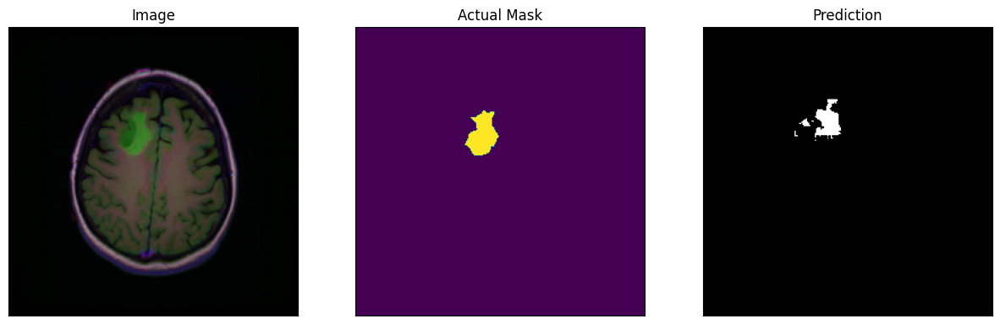

In [75]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(np.array(image), cmap='gray')
axes[0].set_title("Image")

axes[1].imshow(ground_truth_mask)
axes[1].set_title("Actual Mask")

axes[2].imshow(medsam_seg, cmap='gray')
axes[2].set_title("Prediction")

for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
plt.show()

In [76]:
pred = torch.from_numpy(medsam_seg).float()

In [77]:
act = torch.from_numpy(ground_truth_mask).float()

In [78]:
iou = compute_iou(act/255, pred, ignore_empty=False)

iou

tensor(0.3284)

### Prompt: Bounding Box in Image

In [79]:
def draw_bounding_box(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    _, thresh = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    largest_contour = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest_contour)
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

    plt.imshow(image)

    x_min = x
    x_max = x + w
    y_min = y
    y_max = y + h

    return [x_min, y_min, x_max, y_max]


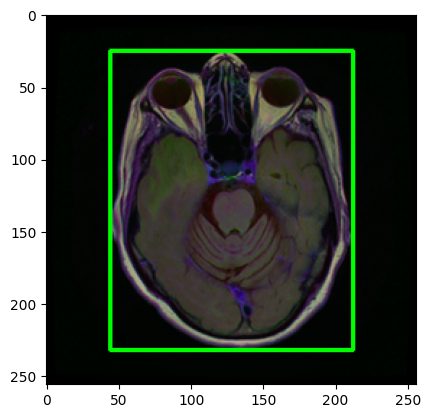

In [80]:
pr = draw_bounding_box(np.array(test_dataset[10]["image"]))

In [81]:
image = test_dataset[10]["image"]
ground_truth_mask = np.array(test_dataset[10]["mask"])

inputs = processor(image, input_boxes=[[pr]], return_tensors="pt").to(device)
for k,v in inputs.items():
  print(k,v.shape)

pixel_values torch.Size([1, 3, 1024, 1024])
original_sizes torch.Size([1, 2])
reshaped_input_sizes torch.Size([1, 2])
input_boxes torch.Size([1, 1, 4])


In [82]:
model.eval()
with torch.no_grad():
  outputs = model(**inputs, multimask_output=False)

In [83]:
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5)

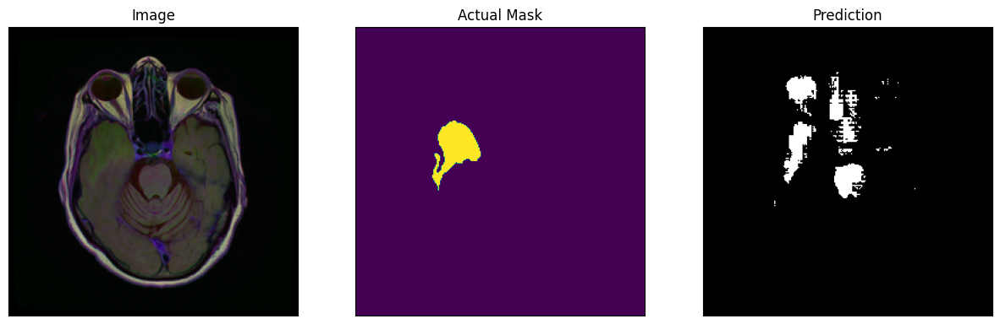

In [84]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

axes[0].imshow(np.array(image), cmap='gray')
axes[0].set_title("Image")
axes[1].imshow(ground_truth_mask)
axes[1].set_title("Actual Mask")
axes[2].imshow(medsam_seg, cmap='gray')
axes[2].set_title("Prediction")

for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

plt.show()